In [1]:
%pip install --upgrade openai
%pip install --upgrade tqdm
%pip install --upgrade python-igraph leidenalg

Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 24.1.1 -> 24.1.2
[notice] To update, run: python.exe -m pip install --upgrade pip


Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 24.1.1 -> 24.1.2
[notice] To update, run: python.exe -m pip install --upgrade pip


Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 24.1.1 -> 24.1.2
[notice] To update, run: python.exe -m pip install --upgrade pip


In [65]:
from openai import OpenAI
from tqdm import tqdm

from src.helper_func.project_util import *

import time
import os

import networkx as nx
import matplotlib.pyplot as plt
from cdlib import algorithms, viz, evaluation

# Preparation

In [29]:
def presentation_layer_prep(nodes, edges):
    p_layer_nodes = [node_id for node_id, node_data in nodes.items() if node_data['properties'].get('layer') == 'Presentation Layer']
    edges_list = []
    edges_list += edges['contains'] + edges['hasScript'] + edges['invokes']
    p_layer_edges = extract_edges(edges_list, p_layer_nodes)
    return p_layer_nodes, p_layer_edges

def p_layer_edges_prep(p_layer_edges, edges):
    p_layer_edges_invokes = [edge for edge in p_layer_edges if edge['label']=='invokes']
    return lift(edges['hasScript'], p_layer_edges_invokes)

def remove_self_calling_edges(lifting_edges):
    return [edge for edge in lifting_edges if edge['source']!=edge['target']]

def weighted_edges_prep(edges):
    return [(edge['source'], edge['target'], edge['properties']['weight']) for edge in edges]

## Graph Network & Community

In [41]:
def list_sorted_connected_components(cc):
    # Sort components by greater size
    sorted_list_ccw = []
    
    for component in cc:
        sorted_list_ccw.append(list(component))
        sorted_list_ccw = sorted(sorted_list_ccw, key=len, reverse=True)
        
    for i, component in enumerate(sorted_list_ccw):
        print(f"Feature {i+1}: {len(component)}")
        
    print(sorted_list_ccw)

In [53]:
def draw_graph(graph):
    # Get the positions of the nodes
    pos = nx.spring_layout(graph)
    
    # Create a new dictionary for label positions
    label_pos = {node: (x, y+0.04) for node, (x, y) in pos.items()}
    plt.figure(figsize=(16, 8))
    
    # Draw the graph
    nx.draw(graph, pos, with_labels=False)
    nx.draw_networkx_labels(graph, label_pos, font_size=10)

In [267]:
def leiden_coms_detect(cc):
    leiden_coms = []
    for i in range(len(cc)):
        # Create a mapping from original node names to integer node names
        node_mapping = {node: j for j, node in enumerate(cc[i].nodes)}
        inv_node_mapping = {j: node for node, j in node_mapping.items()}

        # Create a new graph with integer node names
        G_int = nx.relabel_nodes(cc[i], node_mapping)

        # Apply the Leiden algorithm
        leiden_com = algorithms.leiden(G_int.copy(), weights='weight')
        
        # Convert communities back to original node names
        leiden_com.communities = [[inv_node_mapping[node] for node in community] for community in leiden_com.communities]

        leiden_coms.append(leiden_com)
        print(f'CONNECTED COMPONENTS {i+1}')
        print(f'Average Internal Degree: {evaluation.average_internal_degree(cc[i], leiden_com)}')
        print(f'Modularity Density: {evaluation.modularity_density(cc[i], leiden_com)}')
        print(f'Communities Count: {len(leiden_com.communities)}')
        print(f'Communities: {leiden_com.communities}')
        
    return leiden_coms

## Features Hierarchy

In [289]:
def features_hierarchy(communities, nodes, feat_hierarchy):

    n_current_feat = len(feat_hierarchy)
    for i, coms in enumerate(communities):
        feat_hierarchy['feature_'+str(i+1+n_current_feat)] = dict()
        feat_hierarchy['feature_'+str(i+1+n_current_feat)]['feature_members'] = {
            clasz: {} for clasz in coms
        }
        for cls in feat_hierarchy['feature_'+str(i+1+n_current_feat)]['feature_members'].keys():     
            keys = 'description,reason,howToUse,howItWorks,assertions,roleStereotype,layer'.split(',')
            for key in keys:
                if key in nodes[cls]['properties']:                    
                    feat_hierarchy['feature_'+str(i+1+n_current_feat)]['feature_members'][cls][key] = nodes[cls]['properties'][key]
    
    return feat_hierarchy

In [245]:
def lift_pkg_hierarchy(hierarchy):
    # Manipulate the hierarchy to only contain cls_id and met_id
    lifted_hierarchy = {}
    for pkg_id, cls_dict in hierarchy.items():
        for cls_id, met_ids in cls_dict.items():
            if cls_id not in lifted_hierarchy:
                lifted_hierarchy[cls_id] = []
            lifted_hierarchy[cls_id].extend(met_ids)
    return lifted_hierarchy

In [248]:
def add_method_hierarchy(nodes, node_hierarchy, feat_hierarchy):
    cls_hierarchy = lift_pkg_hierarchy(node_hierarchy)
    for i in range(len(feat_hierarchy)):
        for cls in feat_hierarchy['feature_'+str(i+1)]['feature_members'].keys():            
            keys = 'description,reason,howToUse,howItWorks,assertions,roleStereotype,layer'.split(',')
            met_list = cls_hierarchy[cls]
            feat_hierarchy['feature_'+str(i+1)]['feature_members'][cls]['class_members'] = {
                met: {} for met in met_list
            }
            for met in feat_hierarchy['feature_'+str(i+1)]['feature_members'][cls]['class_members'].keys():
                for key in keys:
                    if key in nodes[met]['properties']:
                        feat_hierarchy['feature_'+str(i+1)]['feature_members'][cls]['class_members'][met][key] = nodes[met]['properties'][key]
    return feat_hierarchy

## OpenAI Prompt & Batch Setup

In [4]:
def setup_and_test_client(client_args, model):
    client = OpenAI(**client_args)
    print(client.base_url)
    print(model)
    
    # test the LLM server---create a completion
    completion = client.chat.completions.create(
        model=model,
        messages=[{"role":"user","content":"What is your name?"}],
        temperature=0
    )
    # print the completion
    print(completion.choices[0].message.content)
    
    return client

In [213]:
sys_role_context_template = '''You are an expert software knowledge analysis assistant, especially in Java projects. Your task is to summarize the software feature description and declare feature name from a list of user interaction classes with the given Automated Source Code Summarization (ASCS) information from user. Think about your answer in a comprehensive description of the software system and not only the user-view. The Java project you will analyse is `{proj_name}` with given description: `{proj_desc}`'''

In [214]:
feat_prompt_template = '''Given a software feature containing the following Java classes:

{classes}

Explain the above feature on the following aspects:
{{ feature_desc: "Briefly describe the purpose/responsibility/functionality of the feature in 1-2 sentence.", 
  feature_name:... }}
  
For the `feature_name`, declare the feature name that you think represents this feature based on its description and classes inside. Do not mention "feature" or "Feature" words in the feature name. Just answer with the name of the feature in camelCase format, and nothing else.

Respond with a well-formatted JSON object. Do not use any quote marks ("'`) within the JSON values. In the `feature_desc`, do not mention any layer name and role stereotype.'''

In [293]:
def feature_batch_prompt(project_name, project_desc, model, nodes, feat_hierarchy):
    """
    Generates a batch of prompts for Feature Identification tasks, and writes them to a JSONL file.

    Parameters:
        project_name (str): The name of the project for which the prompts are being generated.
        project_desc (str): The description of the project for which the prompts are being generated.
        model (str): The name of the OpenAI model to be used for generating the completions.
        nodes (dict): A dictionary representing the nodes in the software knowledge graph.
        feat_hierarchy (dict): A dictionary representing the hierarchy of communities in the software feature.

    Returns:
        None
    """
    
    # Initialize timestamp of the batch file
    timestr = time.strftime("%Y%m%d-%H%M%S")

    # Format the prompt for the system role
    sys_context = sys_role_context_template.format(
        proj_name= project_name, 
        proj_desc= project_desc) 

    # Create the directory if it doesn't exist
    directory = f'2-Features-Identification-logs/{project_name}'
    os.makedirs(directory, exist_ok=True)
    filename = f'{project_name}-features-prompts-batch-{model}-{timestr}'

    # Open a jsonl file to write the batch prompt
    with open(f'{directory}/{filename}.jsonl', 'a', encoding="utf-8") as jsonl_file:
        
        try:
            # Loop over the features in the hierarchy
            for feature in tqdm(feat_hierarchy.keys(), desc='Processing features', position=0):
                # Get the class members for the current feature
                classes = feat_hierarchy[feature]['feature_members']
                
                cls = "\n".join([f"- {nodes[cls_id]['properties']['kind']} `{nodes[cls_id]['properties']['qualifiedName']}`: {describe(nodes[cls_id])}" for cls_id, _ in classes.items()])
                
                # met = "\n".join([f"\t\t- {nodes[met_id]['properties']['kind']} `{nodes[met_id]['properties']['simpleName']}`: {describe(nodes[met_id])}" for cls_id, _ in classes.items() for met_id, _ in classes[cls_id]['class_members'].items()])
                                
                # Format the prompt for the package
                prompt = feat_prompt_template.format(
                    classes=cls #.join(met)
                )

                # Define the request for the feature
                request = {
                    "custom_id": str(feature),
                    "method": "POST",
                    "url": "/v1/chat/completions",
                    "body": {
                        "model": model,
                        "response_format": { "type": "json_object" },
                        "messages": [
                            {"role": "system", "content": sys_context},
                            {"role": "user", "content": prompt}
                        ],
                        "max_tokens": 1024,
                        "temperature": 0
                    }
                }                
                # Write the request to the jsonl file
                jsonl_file.write(json.dumps(request) + "\n")                  

                # Flush the file buffer
                jsonl_file.flush()
                # If a 'stop' file exists, stop the iteration
                if os.path.exists('stop'):
                    raise StopIteration

        # If a StopIteration exception is raised, pass it
        except StopIteration:
            pass
        
    return filename, timestr

In [9]:
def send_batch_request(client, filepath, description):
    """
    Sends a batch request to the OpenAI API using a file and description, returning the created batch request.

    Args:
        client (object): The OpenAI client object used to interact with the API.
        filepath (str): The path to the input file to be uploaded.
        description (str): A description for the batch request metadata.

    Returns:
        object: The created batch request.
    """
    
    # Create a batch input file for the request
    batch_input_file = client.files.create(
        file=open(filepath, "rb"),
        purpose="batch"
    )
    
    batch_input_file_id = batch_input_file.id
    
    # Create the batch request with the input file and metadata
    batch_request = client.batches.create(
        input_file_id=batch_input_file_id,
        endpoint="/v1/chat/completions",
        completion_window="24h",
        metadata={
            "description": description
        }
    )
    
    return batch_request

In [176]:
def merge_batch_output(output_path, *input_texts):
    """
    Merges multiple input text strings into a single output file.

    Args:
        output_path (str): The path to the output file.
        input_texts (str): Variable number of input text strings to be merged.

    Returns:
        None
    """
    
    combined_lines = []
    
    # Read lines from each input text
    for input_text in input_texts:
        lines = input_text.splitlines()
        combined_lines.extend(lines)
    
    # Write combined lines to the output file
    with open(output_path, 'w') as output_file:
        for line in combined_lines:
            output_file.write(line + '\n')

In [241]:
def get_result(batch_output_file, feat_hierarchy):
    # Initialize an empty dictionary to store the results
    results = dict()

    # Open the batch output file
    with open(batch_output_file, 'r', encoding='utf-8') as jsonl_file:
        # Iterate over each line in the file
        for i, line in enumerate(jsonl_file):
            # Load the JSON object from the line
            json_obj = parse_json(line)
            answers = parse_json(json_obj['response']['body']['choices'][0]['message']['content'])
            results[f'feature_{i+1}'] = dict()
            results[f'feature_{i+1}']['feature_name'] = answers['feature_name']
            results[f'feature_{i+1}']['feature_description'] = answers['feature_desc']
           
    # Insert new keys into each feature
    for i, feature in enumerate(results.values()):
        feature["feature_members"] = feat_hierarchy[f'feature_{i+1}']["feature_members"]
    
    # Return the results dictionary
    return results

---
# Small Case Study: Solitaire v1.1

In [122]:
project_name_0, project_desc_0, graph_0, nodes_0, edges_0, client_args_0, model_0 = setup('config-solitaire-v1.1.ini')

(project_name_0, project_desc_0)

('Solitaire (v1.1)', 'Implementation of the Solitaire card game with JavaFX.')

In [123]:
hierarchy_0, nodes_0 = elements_preparation(nodes_0, edges_0)

Methods count: 161
Classes count: 30
Packages count: 4
Project hierarchy count: 4


In [189]:
hierarchy_0

{'ca.mcgill.cs.stg.solitaire.ai': {'ca.mcgill.cs.stg.solitaire.ai.CrashTest': ['ca.mcgill.cs.stg.solitaire.ai.CrashTest.ca.mcgill.cs.stg.solitaire.ai.CrashTest()',
   'ca.mcgill.cs.stg.solitaire.ai.CrashTest.main(java.lang.String[])',
   'ca.mcgill.cs.stg.solitaire.ai.CrashTest.playGame(ca.mcgill.cs.stg.solitaire.model.GameModel)'],
  'ca.mcgill.cs.stg.solitaire.ai.Driver': ['ca.mcgill.cs.stg.solitaire.ai.Driver.ca.mcgill.cs.stg.solitaire.ai.Driver()',
   'ca.mcgill.cs.stg.solitaire.ai.Driver.main(java.lang.String[])',
   'ca.mcgill.cs.stg.solitaire.ai.Driver.playGame(ca.mcgill.cs.stg.solitaire.model.GameModel)'],
  'ca.mcgill.cs.stg.solitaire.ai.GreedyPlayingStrategy': ['ca.mcgill.cs.stg.solitaire.ai.GreedyPlayingStrategy.55cb49fc5f4aa6a9c34d917d2d2f1fd0',
   'ca.mcgill.cs.stg.solitaire.ai.GreedyPlayingStrategy.ca.mcgill.cs.stg.solitaire.ai.GreedyPlayingStrategy()',
   'ca.mcgill.cs.stg.solitaire.ai.GreedyPlayingStrategy.getLegalMove(ca.mcgill.cs.stg.solitaire.model.GameModelView)',
 

In [124]:
nodes_0

{'ca.mcgill.cs.stg.solitaire.model.GameModel$CardMove.aOrigin': {'id': 'ca.mcgill.cs.stg.solitaire.model.GameModel$CardMove.aOrigin',
  'properties': {'sourceText': 'private ca.mcgill.cs.stg.solitaire.model.Location aOrigin;',
   'visibility': 'private',
   'simpleName': 'aOrigin',
   'qualifiedName': 'ca.mcgill.cs.stg.solitaire.model.GameModel$CardMove.aOrigin',
   'kind': 'field',
   'metaSrc': 'source code'},
  'labels': ['Variable']},
 'ca.mcgill.cs.stg.solitaire.model.GameModel.getSubStack(ca.mcgill.cs.stg.solitaire.cards.Card,ca.mcgill.cs.stg.solitaire.model.TableauPile).pCard': {'id': 'ca.mcgill.cs.stg.solitaire.model.GameModel.getSubStack(ca.mcgill.cs.stg.solitaire.cards.Card,ca.mcgill.cs.stg.solitaire.model.TableauPile).pCard',
  'properties': {'simpleName': 'pCard',
   'qualifiedName': 'ca.mcgill.cs.stg.solitaire.model.GameModel.getSubStack(ca.mcgill.cs.stg.solitaire.cards.Card,ca.mcgill.cs.stg.solitaire.model.TableauPile).pCard',
   'kind': 'parameter',
   'metaSrc': 'source

## Selecting User Interaction Components

In [126]:
p_layer_nodes_0, p_layer_edges_0 = presentation_layer_prep(nodes_0, edges_0)

len(p_layer_nodes_0), p_layer_nodes_0

(37,
 ['ca.mcgill.cs.stg.solitaire.gui.CardDragHandler.handle(javafx.scene.input.MouseEvent)',
  'ca.mcgill.cs.stg.solitaire.gui.Solitaire',
  'ca.mcgill.cs.stg.solitaire.gui.DiscardPileView.ca.mcgill.cs.stg.solitaire.gui.DiscardPileView()',
  'ca.mcgill.cs.stg.solitaire.gui.CardPileView.createDragDroppedHandler(javafx.scene.image.ImageView,ca.mcgill.cs.stg.solitaire.cards.Card)',
  'ca.mcgill.cs.stg.solitaire.gui.CardDragHandler.ca.mcgill.cs.stg.solitaire.gui.CardDragHandler(javafx.scene.image.ImageView)',
  'ca.mcgill.cs.stg.solitaire.gui.Solitaire.main(java.lang.String[])',
  'ca.mcgill.cs.stg.solitaire.gui.CardPileView.createDragEnteredHandler(javafx.scene.image.ImageView,ca.mcgill.cs.stg.solitaire.cards.Card)',
  'ca.mcgill.cs.stg.solitaire.model.Tableau.showTop(ca.mcgill.cs.stg.solitaire.model.TableauPile)',
  'ca.mcgill.cs.stg.solitaire.gui.DeckView.gameStateChanged()',
  'ca.mcgill.cs.stg.solitaire.gui.CardPileView.ca.mcgill.cs.stg.solitaire.gui.CardPileView(ca.mcgill.cs.stg.so

In [127]:
len(p_layer_edges_0), p_layer_edges_0

(58,
 [{'id': 'aa4998a09f4b5cd3037069b357a06d69',
   'source': 'ca.mcgill.cs.stg.solitaire.gui',
   'label': 'contains',
   'properties': {'weight': 1, 'metaSrc': 'source code'},
   'target': 'ca.mcgill.cs.stg.solitaire.gui.CardDragHandler'},
  {'id': 'b62f7d592f5ee493e54a53e0bd09930a',
   'source': 'ca.mcgill.cs.stg.solitaire.gui',
   'label': 'contains',
   'properties': {'weight': 1, 'metaSrc': 'source code'},
   'target': 'ca.mcgill.cs.stg.solitaire.gui.CardPileView'},
  {'id': '2d1c4a24f113834020c6d1d5d3153e9c',
   'source': 'ca.mcgill.cs.stg.solitaire.gui',
   'label': 'contains',
   'properties': {'weight': 1, 'metaSrc': 'source code'},
   'target': 'ca.mcgill.cs.stg.solitaire.gui.DeckView'},
  {'id': '8fa896e7d1dc3031ecc2a55336b9cfea',
   'source': 'ca.mcgill.cs.stg.solitaire.gui',
   'label': 'contains',
   'properties': {'weight': 1, 'metaSrc': 'source code'},
   'target': 'ca.mcgill.cs.stg.solitaire.gui.SuitStack'},
  {'id': '454e5e0758f4dc2a524d9655ed2b9545',
   'source': '

In [128]:
lifted_edges_0 = p_layer_edges_prep(p_layer_edges_0, edges_0)

len(lifted_edges_0), lifted_edges_0

(8,
 [{'source': 'ca.mcgill.cs.stg.solitaire.gui.SuitStack',
   'target': 'ca.mcgill.cs.stg.solitaire.gui.SuitStack',
   'label': 'hasScript-invokes-inv_hasScript',
   'properties': {'weight': 1}},
  {'source': 'ca.mcgill.cs.stg.solitaire.gui.CardPileView',
   'target': 'ca.mcgill.cs.stg.solitaire.gui.CardPileView',
   'label': 'hasScript-invokes-inv_hasScript',
   'properties': {'weight': 3}},
  {'source': 'ca.mcgill.cs.stg.solitaire.gui.CardPileView',
   'target': 'ca.mcgill.cs.stg.solitaire.cards.CardImages',
   'label': 'hasScript-invokes-inv_hasScript',
   'properties': {'weight': 1}},
  {'source': 'ca.mcgill.cs.stg.solitaire.gui.DiscardPileView',
   'target': 'ca.mcgill.cs.stg.solitaire.cards.CardImages',
   'label': 'hasScript-invokes-inv_hasScript',
   'properties': {'weight': 1}},
  {'source': 'ca.mcgill.cs.stg.solitaire.gui.DeckView',
   'target': 'ca.mcgill.cs.stg.solitaire.gui.DeckView',
   'label': 'hasScript-invokes-inv_hasScript',
   'properties': {'weight': 1}},
  {'sou

In [129]:
lifted_edges_0 = remove_self_calling_edges(lifted_edges_0)

len(lifted_edges_0), lifted_edges_0

(5,
 [{'source': 'ca.mcgill.cs.stg.solitaire.gui.CardPileView',
   'target': 'ca.mcgill.cs.stg.solitaire.cards.CardImages',
   'label': 'hasScript-invokes-inv_hasScript',
   'properties': {'weight': 1}},
  {'source': 'ca.mcgill.cs.stg.solitaire.gui.DiscardPileView',
   'target': 'ca.mcgill.cs.stg.solitaire.cards.CardImages',
   'label': 'hasScript-invokes-inv_hasScript',
   'properties': {'weight': 1}},
  {'source': 'ca.mcgill.cs.stg.solitaire.gui.DiscardPileView',
   'target': 'ca.mcgill.cs.stg.solitaire.gui.CardDragHandler',
   'label': 'hasScript-invokes-inv_hasScript',
   'properties': {'weight': 1}},
  {'source': 'ca.mcgill.cs.stg.solitaire.gui.SuitStack',
   'target': 'ca.mcgill.cs.stg.solitaire.cards.CardImages',
   'label': 'hasScript-invokes-inv_hasScript',
   'properties': {'weight': 1}},
  {'source': 'ca.mcgill.cs.stg.solitaire.gui.DeckView',
   'target': 'ca.mcgill.cs.stg.solitaire.cards.CardImages',
   'label': 'hasScript-invokes-inv_hasScript',
   'properties': {'weight':

In [130]:
weighted_edges_list_0 = weighted_edges_prep(lifted_edges_0)

len(weighted_edges_list_0), weighted_edges_list_0

(5,
 [('ca.mcgill.cs.stg.solitaire.gui.CardPileView',
   'ca.mcgill.cs.stg.solitaire.cards.CardImages',
   1),
  ('ca.mcgill.cs.stg.solitaire.gui.DiscardPileView',
   'ca.mcgill.cs.stg.solitaire.cards.CardImages',
   1),
  ('ca.mcgill.cs.stg.solitaire.gui.DiscardPileView',
   'ca.mcgill.cs.stg.solitaire.gui.CardDragHandler',
   1),
  ('ca.mcgill.cs.stg.solitaire.gui.SuitStack',
   'ca.mcgill.cs.stg.solitaire.cards.CardImages',
   1),
  ('ca.mcgill.cs.stg.solitaire.gui.DeckView',
   'ca.mcgill.cs.stg.solitaire.cards.CardImages',
   3)])

## Connected Components

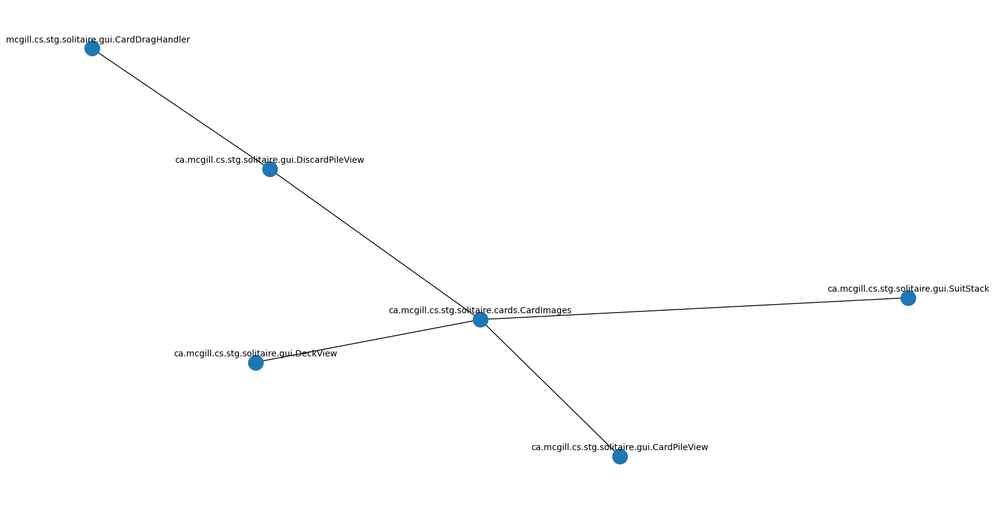

In [131]:
# Create a new graph
G_w_0 = nx.Graph()
    
# Add weighted edges to the graph
G_w_0.add_weighted_edges_from(weighted_edges_list_0)

draw_graph(G_w_0)
plt.show()

In [132]:
# Find connected components
connected_components_w_0 = [G_w_0.subgraph(c).copy() for c in nx.connected_components(G_w_0)]

list_sorted_connected_components(connected_components_w_0)

Feature 1: 6
[['ca.mcgill.cs.stg.solitaire.gui.CardPileView', 'ca.mcgill.cs.stg.solitaire.cards.CardImages', 'ca.mcgill.cs.stg.solitaire.gui.DiscardPileView', 'ca.mcgill.cs.stg.solitaire.gui.CardDragHandler', 'ca.mcgill.cs.stg.solitaire.gui.SuitStack', 'ca.mcgill.cs.stg.solitaire.gui.DeckView']]


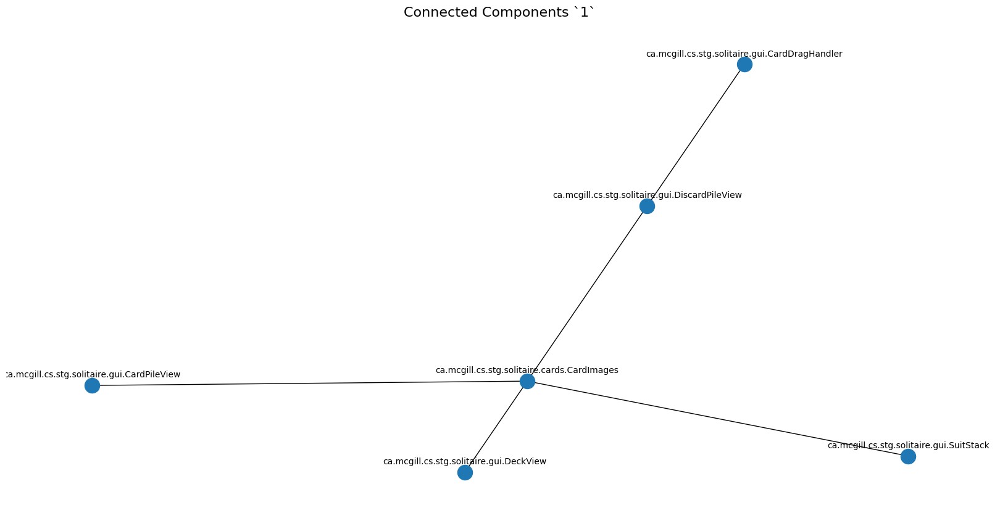

In [133]:
for i, network in enumerate(connected_components_w_0):
    draw_graph(network)
    plt.title(f"Connected Components `{i+1}`", fontdict={'fontsize': 16})
    plt.show()

## Community Detection

In [134]:
leiden_coms_w_0 = leiden_coms_detect(connected_components_w_0)

CONNECTED COMPONENTS 1
KeysView(NodeView((0, 1, 2, 3, 4, 5)))
Average Internal Degree: FitnessResult(min=0, max=0, score=0.0, std=0.0)
Modularity Density: FitnessResult(min=None, max=None, score=0, std=None)
Communities Count: 2
Communities: [['ca.mcgill.cs.stg.solitaire.gui.CardPileView', 'ca.mcgill.cs.stg.solitaire.cards.CardImages', 'ca.mcgill.cs.stg.solitaire.gui.SuitStack', 'ca.mcgill.cs.stg.solitaire.gui.DeckView'], ['ca.mcgill.cs.stg.solitaire.gui.DiscardPileView', 'ca.mcgill.cs.stg.solitaire.gui.CardDragHandler']]


In [135]:
# Refresh variable due to the bug in CDlib algorithm
connected_components_w_0 = [G_w_0.subgraph(c).copy() for c in nx.connected_components(G_w_0)]

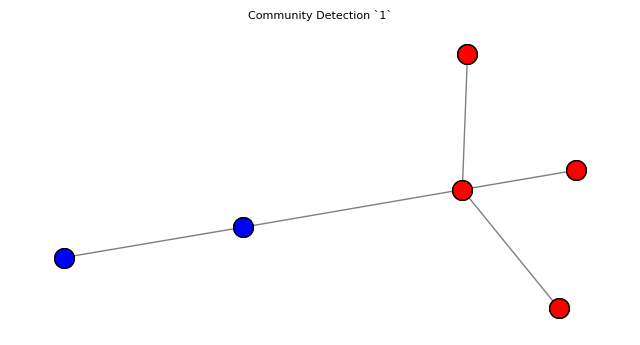

In [136]:
for i, coms in enumerate(leiden_coms_w_0):
    pos = nx.spring_layout(connected_components_w_0[i])
    viz.plot_network_clusters(connected_components_w_0[i], coms, pos, figsize=(8, 4))
    plt.title(f"Community Detection `{i+1}`", fontdict={'fontsize': 8})
    plt.show()

In [137]:
connected_components_w_0[0].nodes

NodeView(('ca.mcgill.cs.stg.solitaire.gui.CardPileView', 'ca.mcgill.cs.stg.solitaire.cards.CardImages', 'ca.mcgill.cs.stg.solitaire.gui.DiscardPileView', 'ca.mcgill.cs.stg.solitaire.gui.CardDragHandler', 'ca.mcgill.cs.stg.solitaire.gui.SuitStack', 'ca.mcgill.cs.stg.solitaire.gui.DeckView'))

In [138]:
connected_components_w_0[0].edges(data=True)

EdgeDataView([('ca.mcgill.cs.stg.solitaire.gui.CardPileView', 'ca.mcgill.cs.stg.solitaire.cards.CardImages', {'weight': 1}), ('ca.mcgill.cs.stg.solitaire.cards.CardImages', 'ca.mcgill.cs.stg.solitaire.gui.DiscardPileView', {'weight': 1}), ('ca.mcgill.cs.stg.solitaire.cards.CardImages', 'ca.mcgill.cs.stg.solitaire.gui.SuitStack', {'weight': 1}), ('ca.mcgill.cs.stg.solitaire.cards.CardImages', 'ca.mcgill.cs.stg.solitaire.gui.DeckView', {'weight': 3}), ('ca.mcgill.cs.stg.solitaire.gui.DiscardPileView', 'ca.mcgill.cs.stg.solitaire.gui.CardDragHandler', {'weight': 1})])

In [144]:
leiden_coms_w_0[0].communities[0]

['ca.mcgill.cs.stg.solitaire.gui.CardPileView',
 'ca.mcgill.cs.stg.solitaire.cards.CardImages',
 'ca.mcgill.cs.stg.solitaire.gui.SuitStack',
 'ca.mcgill.cs.stg.solitaire.gui.DeckView']

In [140]:
leiden_coms_w_0[0].graph.nodes.keys()

KeysView(NodeView((0, 1, 2, 3, 4, 5)))

In [141]:
for i, coms in enumerate(leiden_coms_w_0):
    viz.plot_community_graph(connected_components_w_0[i], coms, figsize=(4, 4))
    plt.title(f"Community Graph `{i+1}`", fontdict={'fontsize': 8})
    plt.show()

KeyError: 'ca.mcgill.cs.stg.solitaire.gui.CardPileView'

## Feature Naming & Description

In [147]:
leiden_coms_w_0

In [234]:
feat_hierarchy_0 = features_hierarchy(leiden_coms_w_0, nodes_0)  #, hierarchy_0)

Features Count: 2
{
  "feature_1": {
    "feat_members": {
      "ca.mcgill.cs.stg.solitaire.gui.CardPileView": {
        "description": "This class is responsible for visually representing and managing the interactions of a card pile in the Solitaire game interface.",
        "roleStereotype": "User Interfacer",
        "layer": "Presentation Layer"
      },
      "ca.mcgill.cs.stg.solitaire.cards.CardImages": {
        "description": "This class is responsible for managing and providing access to card images used in the Solitaire game.",
        "roleStereotype": "Service Provider",
        "layer": "Domain Layer"
      },
      "ca.mcgill.cs.stg.solitaire.gui.SuitStack": {
        "description": "This class is responsible for managing the visual representation and user interactions of a stack of cards in the Solitaire game.",
        "roleStereotype": "User Interfacer",
        "layer": "Presentation Layer"
      },
      "ca.mcgill.cs.stg.solitaire.gui.DeckView": {
        "descrip

In [235]:
feat_hierarchy_0.values()

dict_values([{'feat_members': {'ca.mcgill.cs.stg.solitaire.gui.CardPileView': {'description': 'This class is responsible for visually representing and managing the interactions of a card pile in the Solitaire game interface.', 'roleStereotype': 'User Interfacer', 'layer': 'Presentation Layer'}, 'ca.mcgill.cs.stg.solitaire.cards.CardImages': {'description': 'This class is responsible for managing and providing access to card images used in the Solitaire game.', 'roleStereotype': 'Service Provider', 'layer': 'Domain Layer'}, 'ca.mcgill.cs.stg.solitaire.gui.SuitStack': {'description': 'This class is responsible for managing the visual representation and user interactions of a stack of cards in the Solitaire game.', 'roleStereotype': 'User Interfacer', 'layer': 'Presentation Layer'}, 'ca.mcgill.cs.stg.solitaire.gui.DeckView': {'description': 'This class is responsible for providing a visual representation of the card deck in the Solitaire game and handling user interactions related to it.'

In [156]:
client_0 = setup_and_test_client(client_args_0, model_0)

https://api.openai.com/v1/
gpt-4o-mini
I’m called ChatGPT. How can I assist you today?


In [219]:
filename_0, timestr_0 = feature_batch_prompt(project_name_0, project_desc_0, model_0, nodes_0, feat_hierarchy_0)

Processing features: 100%|██████████| 2/2 [00:00<00:00, 80.00it/s]


In [220]:
input_filepath_0 = f"2-Features-Identification-logs/{project_name_0}/{filename_0}.jsonl"

batch_request_0 = send_batch_request(client_0, input_filepath_0, f"{project_name_0}_features_batch_2048tokens")

batch_request_0

Batch(id='batch_ck3qAFtMJvFeOm63bzpyhcvk', completion_window='24h', created_at=1722183474, endpoint='/v1/chat/completions', input_file_id='file-u7N2EaV6BaMYYFh1ER3O5IVc', object='batch', status='validating', cancelled_at=None, cancelling_at=None, completed_at=None, error_file_id=None, errors=None, expired_at=None, expires_at=1722269874, failed_at=None, finalizing_at=None, in_progress_at=None, metadata={'description': 'Solitaire (v1.1)_features_batch_2048tokens'}, output_file_id=None, request_counts=BatchRequestCounts(completed=0, failed=0, total=0))

In [222]:
batch_request_0 = client_0.batches.retrieve(batch_request_0.id)

batch_request_0

Batch(id='batch_ck3qAFtMJvFeOm63bzpyhcvk', completion_window='24h', created_at=1722183474, endpoint='/v1/chat/completions', input_file_id='file-u7N2EaV6BaMYYFh1ER3O5IVc', object='batch', status='completed', cancelled_at=None, cancelling_at=None, completed_at=1722183675, error_file_id=None, errors=None, expired_at=None, expires_at=1722269874, failed_at=None, finalizing_at=1722183675, in_progress_at=1722183475, metadata={'description': 'Solitaire (v1.1)_features_batch_2048tokens'}, output_file_id='file-FmE2RSvbkX3L9LhfYCcJvqqe', request_counts=BatchRequestCounts(completed=2, failed=0, total=2))

In [223]:
file_response_0 = client_0.files.content(batch_request_0.output_file_id)

batch_output_filepath_0 = f'2-Features-Identification-logs/{project_name_0}/{project_name_0}-features-results-batch-{model_0}-{timestr_0}.jsonl'

merge_batch_output(batch_output_filepath_0, file_response_0.text)

In [242]:
feat_hierarchy_0 = get_result(batch_output_filepath_0, feat_hierarchy_0)

feat_hierarchy_0

{'feature_1': {'feature_name': 'cardInteractionManagement',
  'feature_description': 'This feature is responsible for the visual representation and user interactions of various components in the Solitaire game, including card piles, stacks, and the deck. It ensures that players can interact with the game elements effectively through a graphical interface.',
  'feature_members': {'ca.mcgill.cs.stg.solitaire.gui.CardPileView': {'description': 'This class is responsible for visually representing and managing the interactions of a card pile in the Solitaire game interface.',
    'roleStereotype': 'User Interfacer',
    'layer': 'Presentation Layer'},
   'ca.mcgill.cs.stg.solitaire.cards.CardImages': {'description': 'This class is responsible for managing and providing access to card images used in the Solitaire game.',
    'roleStereotype': 'Service Provider',
    'layer': 'Domain Layer'},
   'ca.mcgill.cs.stg.solitaire.gui.SuitStack': {'description': 'This class is responsible for managin

In [249]:
feat_hierarchy_0 = add_method_hierarchy(nodes_0, hierarchy_0, feat_hierarchy_0)

feat_hierarchy_0

{'feature_1': {'feature_name': 'cardInteractionManagement',
  'feature_description': 'This feature is responsible for the visual representation and user interactions of various components in the Solitaire game, including card piles, stacks, and the deck. It ensures that players can interact with the game elements effectively through a graphical interface.',
  'feature_members': {'ca.mcgill.cs.stg.solitaire.gui.CardPileView': {'description': 'This class is responsible for visually representing and managing the interactions of a card pile in the Solitaire game interface.',
    'roleStereotype': 'User Interfacer',
    'layer': 'Presentation Layer',
    'class_members': {'ca.mcgill.cs.stg.solitaire.gui.CardPileView.buildLayout()': {'description': 'The method builds the visual layout of a card pile in the Solitaire game by adding card images to the UI based on the current state of the card stack.',
      'reason': 'The method is provided to dynamically create and update the visual represent

In [250]:
write_to_json_file(feat_hierarchy_0, f'../test/output/2-Features-Identification/{project_name_0}-features-{model_0}-{timestr_0}.json')

---
# Case Study 1: JHotDraw v5.1

In [252]:
project_name_1, project_desc_1, graph_1, nodes_1, edges_1, client_args_1, model_1 = setup('config-jhotdraw-v5.1.ini')

(project_name_1, project_desc_1)

('JHotDraw (v5.1)',
 'JHotDraw is a two-dimensional graphics framework for structured drawing editors that is written in Java.')

In [253]:
hierarchy_1, nodes_1 = elements_preparation(nodes_1, edges_1)

Methods count: 1194
Classes count: 136
Packages count: 7
Project hierarchy count: 7


In [254]:
hierarchy_1

{'CH.ifa.draw.applet': {'CH.ifa.draw.applet.DrawApplet': ['CH.ifa.draw.applet.DrawApplet.CH.ifa.draw.applet.DrawApplet()',
   'CH.ifa.draw.applet.DrawApplet.createAttributeChoices(java.awt.Panel)',
   'CH.ifa.draw.applet.DrawApplet.createAttributesPanel()',
   'CH.ifa.draw.applet.DrawApplet.createButtonPanel()',
   'CH.ifa.draw.applet.DrawApplet.createButtons(java.awt.Panel)',
   'CH.ifa.draw.applet.DrawApplet.createColorChoice(java.lang.String)',
   'CH.ifa.draw.applet.DrawApplet.createDrawing()',
   'CH.ifa.draw.applet.DrawApplet.createDrawingView()',
   'CH.ifa.draw.applet.DrawApplet.createFontChoice()',
   'CH.ifa.draw.applet.DrawApplet.createSelectionTool()',
   'CH.ifa.draw.applet.DrawApplet.createToolButton(java.lang.String,java.lang.String,CH.ifa.draw.framework.Tool)',
   'CH.ifa.draw.applet.DrawApplet.createToolPalette()',
   'CH.ifa.draw.applet.DrawApplet.createTools(java.awt.Panel)',
   'CH.ifa.draw.applet.DrawApplet.drawing()',
   'CH.ifa.draw.applet.DrawApplet.guessType(ja

## Selecting User Interaction Components

In [255]:
p_layer_nodes_1, p_layer_edges_1 = presentation_layer_prep(nodes_1, edges_1)

len(p_layer_nodes_1), p_layer_nodes_1

(593,
 ['CH.ifa.draw.framework.DrawingChangeListener.drawingInvalidated(CH.ifa.draw.framework.DrawingChangeEvent)',
  'CH.ifa.draw.standard.WestHandle.invokeStep(int,int,int,int,CH.ifa.draw.framework.DrawingView)',
  'CH.ifa.draw.framework.DrawingView.drawBackground(java.awt.Graphics)',
  'CH.ifa.draw.util.PaletteButton.CH.ifa.draw.util.PaletteButton(CH.ifa.draw.util.PaletteListener)',
  'CH.ifa.draw.standard.StandardDrawingView.selectionZOrdered()',
  'CH.ifa.draw.figures.AttributeFigure.drawFrame(java.awt.Graphics)',
  'CH.ifa.draw.standard.BoxHandleKit',
  'CH.ifa.draw.standard.AbstractFigure.size()',
  'CH.ifa.draw.framework.Figure.displayBox()',
  'CH.ifa.draw.figures.TextFigure.textDisplayBox()',
  'CH.ifa.draw.standard.DragTracker.CH.ifa.draw.standard.DragTracker(CH.ifa.draw.framework.DrawingView,CH.ifa.draw.framework.Figure)',
  'CH.ifa.draw.util.PaletteIcon.pressed()',
  'CH.ifa.draw.util.FloatingTextField.addActionListener(java.awt.event.ActionListener)',
  'CH.ifa.draw.frame

In [256]:
len(p_layer_edges_1), p_layer_edges_1

(811,
 [{'id': 'e9d0c9407cee3e4cbcfb5fd968e96362',
   'source': 'CH.ifa.draw.applet',
   'label': 'contains',
   'properties': {'weight': 1, 'metaSrc': 'source code'},
   'target': 'CH.ifa.draw.applet.DrawApplet'},
  {'id': 'dec03140c292de57f9a33829270b9fe3',
   'source': 'CH.ifa.draw.application',
   'label': 'contains',
   'properties': {'weight': 1, 'metaSrc': 'source code'},
   'target': 'CH.ifa.draw.application.DrawApplication'},
  {'id': 'd57641f36f917a5a5a5f3db8bf23e57f',
   'source': 'CH.ifa.draw.standard.SelectionTool',
   'label': 'hasScript',
   'properties': {'weight': 1, 'metaSrc': 'source code'},
   'target': 'CH.ifa.draw.standard.SelectionTool.createHandleTracker(CH.ifa.draw.framework.DrawingView,CH.ifa.draw.framework.Handle)'},
  {'id': '58da88a0d0903d138f803a374c1c5cf5',
   'source': 'CH.ifa.draw.framework.Tool',
   'label': 'hasScript',
   'properties': {'weight': 1, 'metaSrc': 'source code'},
   'target': 'CH.ifa.draw.framework.Tool.mouseDown(java.awt.event.MouseEven

In [257]:
lifted_edges_1 = p_layer_edges_prep(p_layer_edges_1, edges_1)

len(lifted_edges_1), lifted_edges_1

(137,
 [{'source': 'CH.ifa.draw.figures.PolyLineFigure',
   'target': 'CH.ifa.draw.figures.LineDecoration',
   'label': 'hasScript-invokes-inv_hasScript',
   'properties': {'weight': 2}},
  {'source': 'CH.ifa.draw.figures.RectangleFigure',
   'target': 'CH.ifa.draw.standard.BoxHandleKit',
   'label': 'hasScript-invokes-inv_hasScript',
   'properties': {'weight': 1}},
  {'source': 'CH.ifa.draw.standard.RelativeLocator',
   'target': 'CH.ifa.draw.framework.Figure',
   'label': 'hasScript-invokes-inv_hasScript',
   'properties': {'weight': 1}},
  {'source': 'CH.ifa.draw.figures.AttributeFigure',
   'target': 'CH.ifa.draw.figures.AttributeFigure',
   'label': 'hasScript-invokes-inv_hasScript',
   'properties': {'weight': 1}},
  {'source': 'CH.ifa.draw.standard.StandardDrawingView',
   'target': 'CH.ifa.draw.standard.StandardDrawingView',
   'label': 'hasScript-invokes-inv_hasScript',
   'properties': {'weight': 13}},
  {'source': 'CH.ifa.draw.standard.AbstractFigure',
   'target': 'CH.ifa.

In [258]:
lifted_edges_1 = remove_self_calling_edges(lifted_edges_1)

len(lifted_edges_1), lifted_edges_1

(106,
 [{'source': 'CH.ifa.draw.figures.PolyLineFigure',
   'target': 'CH.ifa.draw.figures.LineDecoration',
   'label': 'hasScript-invokes-inv_hasScript',
   'properties': {'weight': 2}},
  {'source': 'CH.ifa.draw.figures.RectangleFigure',
   'target': 'CH.ifa.draw.standard.BoxHandleKit',
   'label': 'hasScript-invokes-inv_hasScript',
   'properties': {'weight': 1}},
  {'source': 'CH.ifa.draw.standard.RelativeLocator',
   'target': 'CH.ifa.draw.framework.Figure',
   'label': 'hasScript-invokes-inv_hasScript',
   'properties': {'weight': 1}},
  {'source': 'CH.ifa.draw.contrib.PolygonTool',
   'target': 'CH.ifa.draw.framework.DrawingView',
   'label': 'hasScript-invokes-inv_hasScript',
   'properties': {'weight': 2}},
  {'source': 'CH.ifa.draw.figures.FontSizeHandle',
   'target': 'CH.ifa.draw.standard.LocatorHandle',
   'label': 'hasScript-invokes-inv_hasScript',
   'properties': {'weight': 1}},
  {'source': 'CH.ifa.draw.standard.SelectAreaTracker',
   'target': 'CH.ifa.draw.standard.Ab

In [259]:
weighted_edges_list_1 = weighted_edges_prep(lifted_edges_1)

len(weighted_edges_list_1), weighted_edges_list_1

(106,
 [('CH.ifa.draw.figures.PolyLineFigure',
   'CH.ifa.draw.figures.LineDecoration',
   2),
  ('CH.ifa.draw.figures.RectangleFigure',
   'CH.ifa.draw.standard.BoxHandleKit',
   1),
  ('CH.ifa.draw.standard.RelativeLocator', 'CH.ifa.draw.framework.Figure', 1),
  ('CH.ifa.draw.contrib.PolygonTool', 'CH.ifa.draw.framework.DrawingView', 2),
  ('CH.ifa.draw.figures.FontSizeHandle',
   'CH.ifa.draw.standard.LocatorHandle',
   1),
  ('CH.ifa.draw.standard.SelectAreaTracker',
   'CH.ifa.draw.standard.AbstractTool',
   1),
  ('CH.ifa.draw.figures.RoundRectangleFigure',
   'CH.ifa.draw.standard.BoxHandleKit',
   1),
  ('CH.ifa.draw.figures.GroupCommand', 'CH.ifa.draw.framework.DrawingView', 2),
  ('CH.ifa.draw.application.DrawApplication',
   'CH.ifa.draw.util.CommandMenu',
   24),
  ('CH.ifa.draw.standard.DragTracker', 'CH.ifa.draw.standard.AbstractTool', 1),
  ('CH.ifa.draw.applet.DrawApplet',
   'CH.ifa.draw.standard.StandardDrawingView',
   3),
  ('CH.ifa.draw.standard.BringToFrontCommand

## Connected Components

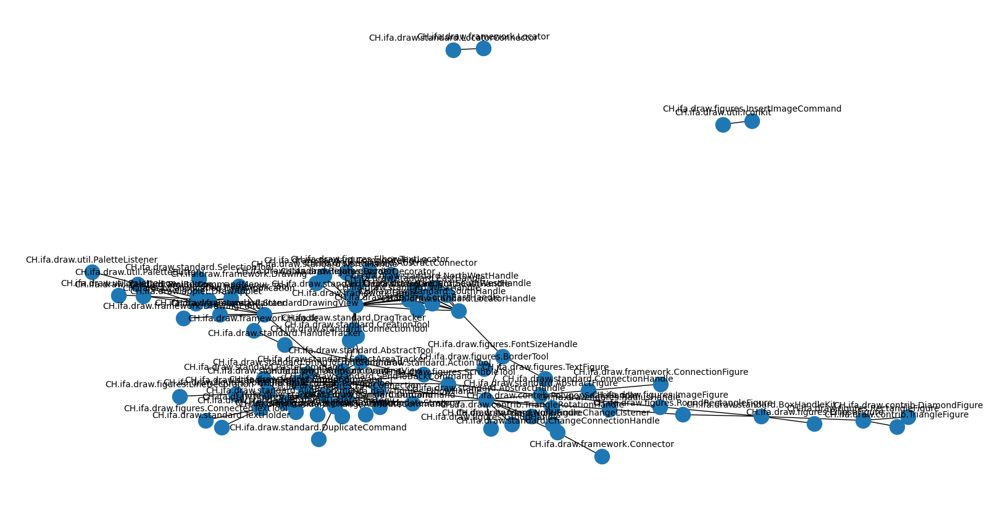

In [260]:
# Create a new graph
G_w_1 = nx.Graph()
    
# Add weighted edges to the graph
G_w_1.add_weighted_edges_from(weighted_edges_list_1)

draw_graph(G_w_1)
plt.show()

In [261]:
# Find connected components
connected_components_w_1 = [G_w_1.subgraph(c).copy() for c in nx.connected_components(G_w_1)]

list_sorted_connected_components(connected_components_w_1)

Feature 1: 83
Feature 2: 2
Feature 3: 2
[['CH.ifa.draw.figures.PolyLineFigure', 'CH.ifa.draw.figures.LineDecoration', 'CH.ifa.draw.figures.RectangleFigure', 'CH.ifa.draw.standard.BoxHandleKit', 'CH.ifa.draw.standard.RelativeLocator', 'CH.ifa.draw.framework.Figure', 'CH.ifa.draw.contrib.PolygonTool', 'CH.ifa.draw.framework.DrawingView', 'CH.ifa.draw.figures.FontSizeHandle', 'CH.ifa.draw.standard.LocatorHandle', 'CH.ifa.draw.standard.SelectAreaTracker', 'CH.ifa.draw.standard.AbstractTool', 'CH.ifa.draw.figures.RoundRectangleFigure', 'CH.ifa.draw.figures.GroupCommand', 'CH.ifa.draw.application.DrawApplication', 'CH.ifa.draw.util.CommandMenu', 'CH.ifa.draw.standard.DragTracker', 'CH.ifa.draw.applet.DrawApplet', 'CH.ifa.draw.standard.StandardDrawingView', 'CH.ifa.draw.standard.BringToFrontCommand', 'CH.ifa.draw.figures.ElbowHandle', 'CH.ifa.draw.figures.LineConnection', 'CH.ifa.draw.figures.TextTool', 'CH.ifa.draw.standard.TextHolder', 'CH.ifa.draw.standard.ConnectionHandle', 'CH.ifa.draw.f

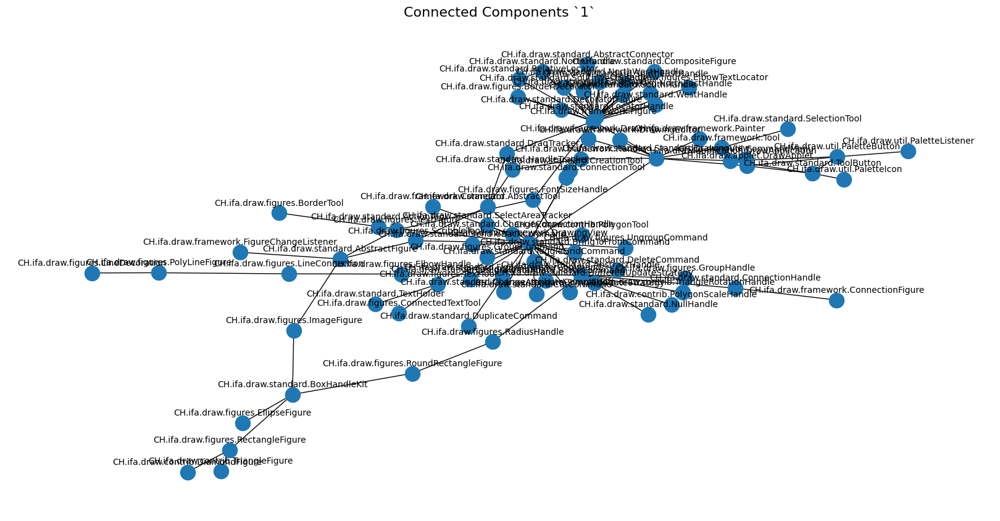

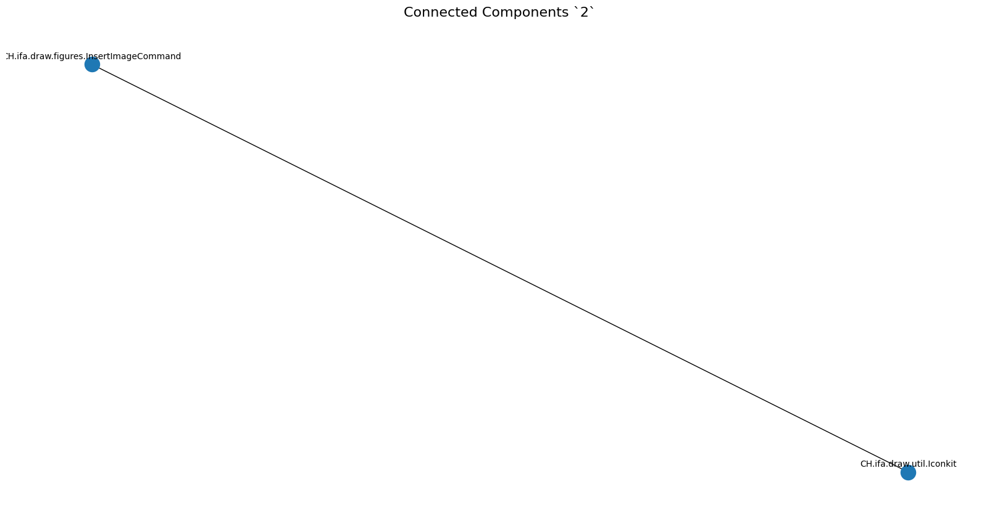

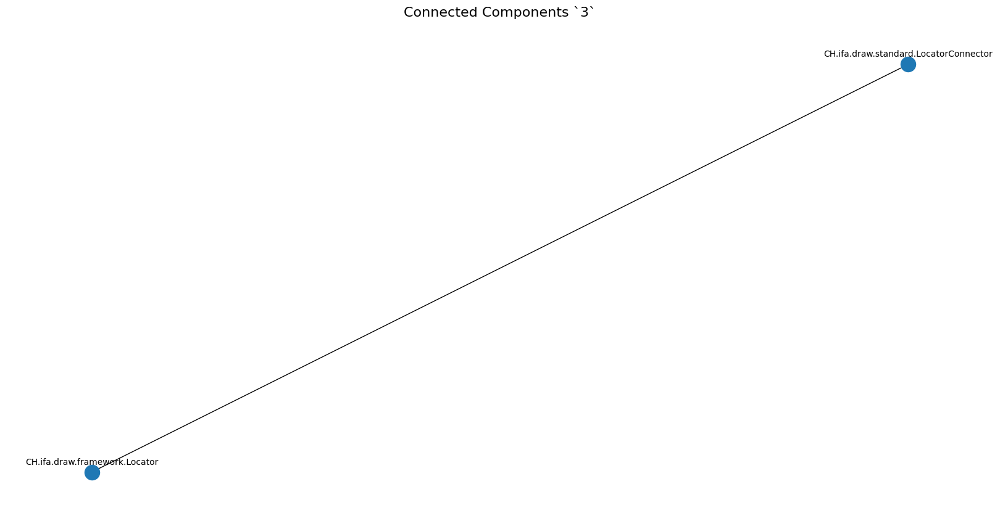

In [262]:
for i, network in enumerate(connected_components_w_1):
    draw_graph(network)
    plt.title(f"Connected Components `{i+1}`", fontdict={'fontsize': 16})
    plt.show()

## Community Detection

In [269]:
leiden_coms_w_1 = leiden_coms_detect(connected_components_w_1)

CONNECTED COMPONENTS 1
Average Internal Degree: FitnessResult(min=1.0, max=2.736842105263158, score=1.8079935415461732, std=0.4629277549751127)
Modularity Density: FitnessResult(min=None, max=None, score=8.725369723081393, std=None)
Communities Count: 8
Communities: [['CH.ifa.draw.contrib.PolygonTool', 'CH.ifa.draw.framework.DrawingView', 'CH.ifa.draw.standard.SelectAreaTracker', 'CH.ifa.draw.standard.AbstractTool', 'CH.ifa.draw.figures.GroupCommand', 'CH.ifa.draw.standard.BringToFrontCommand', 'CH.ifa.draw.figures.TextTool', 'CH.ifa.draw.standard.TextHolder', 'CH.ifa.draw.standard.DuplicateCommand', 'CH.ifa.draw.standard.FigureTransferCommand', 'CH.ifa.draw.standard.SimpleUpdateStrategy', 'CH.ifa.draw.standard.ActionTool', 'CH.ifa.draw.figures.UngroupCommand', 'CH.ifa.draw.standard.ChangeAttributeCommand', 'CH.ifa.draw.figures.ConnectedTextTool', 'CH.ifa.draw.standard.AlignCommand', 'CH.ifa.draw.standard.ToggleGridCommand', 'CH.ifa.draw.standard.DeleteCommand', 'CH.ifa.draw.figures.Bo

In [270]:
# Refresh variable due to the bug in CDlib algorithm
connected_components_w_1 = [G_w_1.subgraph(c).copy() for c in nx.connected_components(G_w_1)]

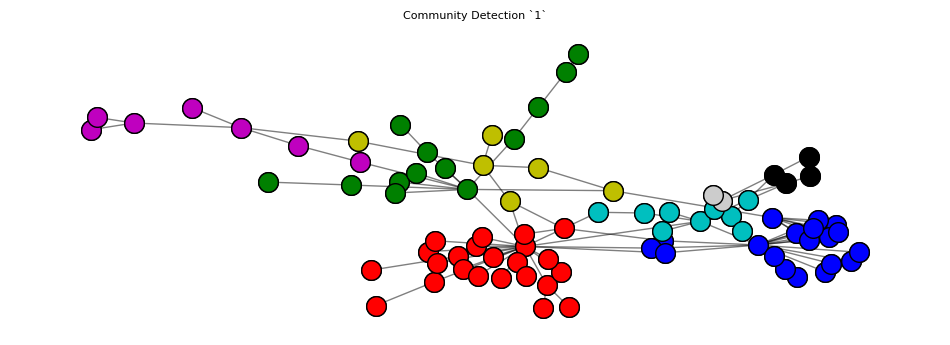

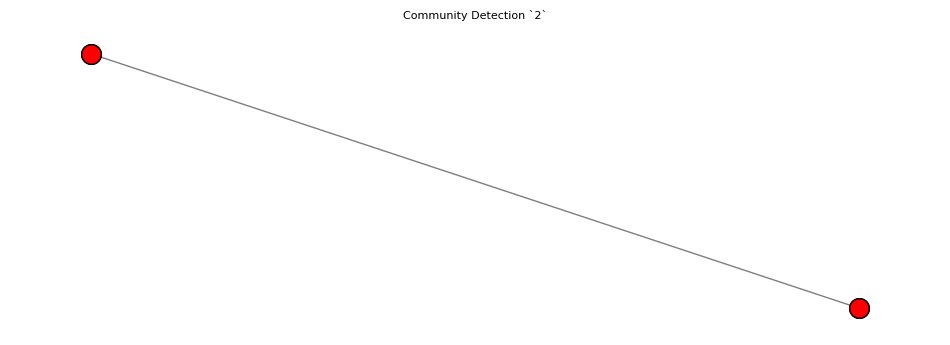

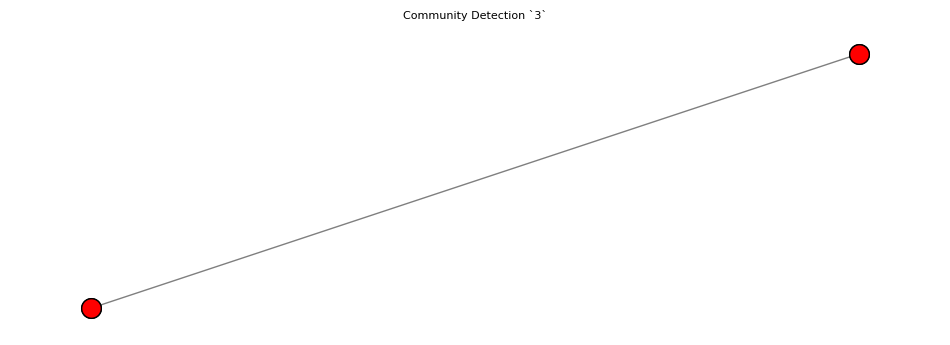

In [272]:
for i, coms in enumerate(leiden_coms_w_1):
    pos = nx.spring_layout(connected_components_w_1[i])
    viz.plot_network_clusters(connected_components_w_1[i], coms, pos, figsize=(12, 4))
    plt.title(f"Community Detection `{i+1}`", fontdict={'fontsize': 8})
    plt.show()

In [273]:
for i, coms in enumerate(leiden_coms_w_1):
    viz.plot_community_graph(connected_components_w_1[i], coms, figsize=(4, 4))
    plt.title(f"Community Graph `{i+1}`", fontdict={'fontsize': 8})
    plt.show()

KeyError: 'CH.ifa.draw.contrib.PolygonTool'

## Feature Naming & Description

In [290]:
feat_hierarchy_1 = dict()           

for i in range(len(leiden_coms_w_1)):
    feat_hierarchy_1 = features_hierarchy(leiden_coms_w_1[i].communities, nodes_1, feat_hierarchy_1)

print(f'Features Count: {len(feat_hierarchy_1)}')
print(prettify_json(feat_hierarchy_1))

Features Count: 10
{
  "feature_1": {
    "feature_members": {
      "CH.ifa.draw.contrib.PolygonTool": {
        "description": "This class is responsible for providing tools to create and manipulate polygon shapes within a drawing application.",
        "roleStereotype": "User Interfacer",
        "layer": "Presentation Layer"
      },
      "CH.ifa.draw.framework.DrawingView": {
        "description": "This interface is responsible for defining the methods required to manage and interact with the visual representation of a drawing in a structured drawing editor.",
        "roleStereotype": "User Interfacer",
        "layer": "Presentation Layer"
      },
      "CH.ifa.draw.standard.SelectAreaTracker": {
        "description": "This class is responsible for managing the selection area within a drawing application, allowing users to visually select and manipulate graphical elements.",
        "roleStereotype": "User Interfacer",
        "layer": "Presentation Layer"
      },
      "CH

In [291]:
client_1 = setup_and_test_client(client_args_1, model_1)

https://api.openai.com/v1/
gpt-4o-mini
I’m called ChatGPT. How can I assist you today?


In [294]:
filename_1, timestr_1 = feature_batch_prompt(project_name_1, project_desc_1, model_1, nodes_1, feat_hierarchy_1)

Processing features: 100%|██████████| 10/10 [00:00<00:00, 1814.46it/s]


In [295]:
input_filepath_1 = f"2-Features-Identification-logs/{project_name_1}/{filename_1}.jsonl"

batch_request_1 = send_batch_request(client_1, input_filepath_1, f"{project_name_1}_features_batch_1024tokens")

batch_request_1

Batch(id='batch_UtUZ75QANZpiHR4uhxzBv477', completion_window='24h', created_at=1722191665, endpoint='/v1/chat/completions', input_file_id='file-8ij38pXj1cgHAwgAmTSBrb0a', object='batch', status='validating', cancelled_at=None, cancelling_at=None, completed_at=None, error_file_id=None, errors=None, expired_at=None, expires_at=1722278065, failed_at=None, finalizing_at=None, in_progress_at=None, metadata={'description': 'JHotDraw (v5.1)_features_batch_1024tokens'}, output_file_id=None, request_counts=BatchRequestCounts(completed=0, failed=0, total=0))

In [297]:
batch_request_1 = client_1.batches.retrieve(batch_request_1.id)

batch_request_1

Batch(id='batch_UtUZ75QANZpiHR4uhxzBv477', completion_window='24h', created_at=1722191665, endpoint='/v1/chat/completions', input_file_id='file-8ij38pXj1cgHAwgAmTSBrb0a', object='batch', status='completed', cancelled_at=None, cancelling_at=None, completed_at=1722192330, error_file_id=None, errors=None, expired_at=None, expires_at=1722278065, failed_at=None, finalizing_at=1722192329, in_progress_at=1722191665, metadata={'description': 'JHotDraw (v5.1)_features_batch_1024tokens'}, output_file_id='file-eNhhTDWsXACf7FzcgjBmSf5N', request_counts=BatchRequestCounts(completed=10, failed=0, total=10))

In [298]:
file_response_1 = client_1.files.content(batch_request_1.output_file_id)

batch_output_filepath_1 = f'2-Features-Identification-logs/{project_name_1}/{project_name_1}-features-results-batch-{model_1}-{timestr_1}.jsonl'

merge_batch_output(batch_output_filepath_1, file_response_1.text)

feat_hierarchy_1 = get_result(batch_output_filepath_1, feat_hierarchy_1)

feat_hierarchy_1

{'feature_1': {'feature_name': 'drawingEditorTools',
  'feature_description': 'This feature provides a comprehensive set of tools and commands for creating, manipulating, and managing graphical elements within a structured drawing editor, enabling users to perform various operations such as selection, grouping, alignment, and text editing.',
  'feature_members': {'CH.ifa.draw.contrib.PolygonTool': {'description': 'This class is responsible for providing tools to create and manipulate polygon shapes within a drawing application.',
    'roleStereotype': 'User Interfacer',
    'layer': 'Presentation Layer'},
   'CH.ifa.draw.framework.DrawingView': {'description': 'This interface is responsible for defining the methods required to manage and interact with the visual representation of a drawing in a structured drawing editor.',
    'roleStereotype': 'User Interfacer',
    'layer': 'Presentation Layer'},
   'CH.ifa.draw.standard.SelectAreaTracker': {'description': 'This class is responsible 

In [299]:
feat_hierarchy_1 = add_method_hierarchy(nodes_1, hierarchy_1, feat_hierarchy_1)

feat_hierarchy_1

{'feature_1': {'feature_name': 'drawingEditorTools',
  'feature_description': 'This feature provides a comprehensive set of tools and commands for creating, manipulating, and managing graphical elements within a structured drawing editor, enabling users to perform various operations such as selection, grouping, alignment, and text editing.',
  'feature_members': {'CH.ifa.draw.contrib.PolygonTool': {'description': 'This class is responsible for providing tools to create and manipulate polygon shapes within a drawing application.',
    'roleStereotype': 'User Interfacer',
    'layer': 'Presentation Layer',
    'class_members': {'CH.ifa.draw.contrib.PolygonTool.CH.ifa.draw.contrib.PolygonTool(CH.ifa.draw.framework.DrawingView)': {'description': 'The method initializes a PolygonTool instance with a specified DrawingView.',
      'reason': 'This constructor is provided to create a PolygonTool that is associated with a specific DrawingView for drawing polygon shapes.',
      'howToUse': 'To 

In [300]:
write_to_json_file(feat_hierarchy_1, f'../test/output/2-Features-Identification/{project_name_1}-features-{model_1}-{timestr_1}.json')

---
# Case Study 2: Bitcoin Wallet v6.31

In [301]:
project_name_2, project_desc_2, graph_2, nodes_2, edges_2, client_args_2, model_2 = setup('config-bitcoin-wallet-v6.31.ini')

(project_name_2, project_desc_2)

('Bitcoin Wallet (v6.31)',
 'Bitcoin Wallet, a standalone Bitcoin payment app for your Android device!')

In [302]:
hierarchy_2, nodes_2 = elements_preparation(nodes_2, edges_2)

Methods count: 1253
Classes count: 229
Packages count: 12
Project hierarchy count: 12


In [303]:
hierarchy_2

{'de.schildbach.wallet': {'de.schildbach.wallet.Configuration': ['de.schildbach.wallet.Configuration.armBackupReminder()',
   'de.schildbach.wallet.Configuration.changeLogVersionCodeCrossed(int,int)',
   'de.schildbach.wallet.Configuration.de.schildbach.wallet.Configuration(android.content.SharedPreferences,android.content.res.Resources)',
   'de.schildbach.wallet.Configuration.disarmBackupReminder()',
   'de.schildbach.wallet.Configuration.getBestChainHeightEver()',
   'de.schildbach.wallet.Configuration.getBlockExplorer()',
   'de.schildbach.wallet.Configuration.getBtcBase()',
   'de.schildbach.wallet.Configuration.getBtcPrecision()',
   'de.schildbach.wallet.Configuration.getBtcShift()',
   'de.schildbach.wallet.Configuration.getCachedExchangeRate()',
   'de.schildbach.wallet.Configuration.getConnectivityNotificationEnabled()',
   'de.schildbach.wallet.Configuration.getDisclaimerEnabled()',
   'de.schildbach.wallet.Configuration.getExchangeCurrencyCode()',
   'de.schildbach.wallet.C

## Selecting User Interaction Components

In [304]:
p_layer_nodes_2, p_layer_edges_2 = presentation_layer_prep(nodes_2, edges_2)

len(p_layer_nodes_2), p_layer_nodes_2

(881,
 ['de.schildbach.wallet.ui.WalletDisclaimerFragment.onCreate(android.os.Bundle)',
  'de.schildbach.wallet.ui.CurrencyAmountView.setContextButton(int,de.schildbach.wallet.ui.OnClickListener)',
  'de.schildbach.wallet.ui.TransactionsAdapter$TransactionViewHolder.bindMessage(de.schildbach.wallet.ui.TransactionsAdapter$ListItem$TransactionItem)',
  'de.schildbach.wallet.ui.WalletActivity.de.schildbach.wallet.ui.WalletActivity()',
  'de.schildbach.wallet.util.CheatSheet.remove(android.view.View)',
  'de.schildbach.wallet.ui.monitor.BlockListFragment$TransactionsLiveData.onWalletActive(org.bitcoinj.wallet.Wallet)',
  'de.schildbach.wallet.ui.monitor.NetworkMonitorActivity$PagerAdapter.de.schildbach.wallet.ui.monitor.NetworkMonitorActivity$PagerAdapter(android.support.v4.app.FragmentManager)',
  'de.schildbach.wallet.ui.CurrencySymbolDrawable.draw(android.graphics.Canvas)',
  'de.schildbach.wallet.ui.WalletViewModel$EnterAnimationState.de.schildbach.wallet.ui.WalletViewModel$EnterAnimat

In [305]:
len(p_layer_edges_2), p_layer_edges_2

(1302,
 [{'id': '94d1142fdafeeea252421e5f3d60a081',
   'source': 'de.schildbach.wallet.ui',
   'label': 'contains',
   'properties': {'weight': 1, 'metaSrc': 'source code'},
   'target': 'de.schildbach.wallet.ui.EncryptKeysDialogFragment'},
  {'id': 'aa704992d555c05cbda28431e2a38aac',
   'source': 'de.schildbach.wallet.ui.scan',
   'label': 'contains',
   'properties': {'weight': 1, 'metaSrc': 'source code'},
   'target': 'de.schildbach.wallet.ui.scan.ScanActivity'},
  {'id': '33b56a00c6406a77617a2780d20e5202',
   'source': 'de.schildbach.wallet.ui.scan',
   'label': 'contains',
   'properties': {'weight': 1, 'metaSrc': 'source code'},
   'target': 'de.schildbach.wallet.ui.scan.ScanActivity$WarnDialogFragment'},
  {'id': 'db4e0cb3750a297c82411078af89f2e5',
   'source': 'de.schildbach.wallet.ui.monitor',
   'label': 'contains',
   'properties': {'weight': 1, 'metaSrc': 'source code'},
   'target': 'de.schildbach.wallet.ui.monitor.NetworkMonitorActivity'},
  {'id': '159db2ce8f9db84f9303f

In [306]:
lifted_edges_2 = p_layer_edges_prep(p_layer_edges_2, edges_2)

len(lifted_edges_2), lifted_edges_2

(155,
 [{'source': 'de.schildbach.wallet.ui.MaybeMaintenanceViewModel',
   'target': 'de.schildbach.wallet.ui.MaybeMaintenanceViewModel',
   'label': 'hasScript-invokes-inv_hasScript',
   'properties': {'weight': 2}},
  {'source': 'de.schildbach.wallet.ui.SendingAddressesFragment',
   'target': 'de.schildbach.wallet.ui.SendingAddressesFragment',
   'label': 'hasScript-invokes-inv_hasScript',
   'properties': {'weight': 3}},
  {'source': 'de.schildbach.wallet.ui.RequestCoinsFragment',
   'target': 'de.schildbach.wallet.ui.RequestCoinsFragment',
   'label': 'hasScript-invokes-inv_hasScript',
   'properties': {'weight': 3}},
  {'source': 'de.schildbach.wallet.util.Toast',
   'target': 'de.schildbach.wallet.util.Toast',
   'label': 'hasScript-invokes-inv_hasScript',
   'properties': {'weight': 9}},
  {'source': 'de.schildbach.wallet.ui.ExchangeRatesActivity',
   'target': 'de.schildbach.wallet.ui.AbstractWalletActivity',
   'label': 'hasScript-invokes-inv_hasScript',
   'properties': {'wei

In [307]:
lifted_edges_2 = remove_self_calling_edges(lifted_edges_2)

len(lifted_edges_2), lifted_edges_2

(102,
 [{'source': 'de.schildbach.wallet.ui.ExchangeRatesActivity',
   'target': 'de.schildbach.wallet.ui.AbstractWalletActivity',
   'label': 'hasScript-invokes-inv_hasScript',
   'properties': {'weight': 2}},
  {'source': 'de.schildbach.wallet.ui.RequestCoinsFragment',
   'target': 'de.schildbach.wallet.ui.CurrencyCalculatorLink',
   'label': 'hasScript-invokes-inv_hasScript',
   'properties': {'weight': 3}},
  {'source': 'de.schildbach.wallet.ui.WalletActivity',
   'target': 'de.schildbach.wallet.ui.ReportIssueDialogFragment',
   'label': 'hasScript-invokes-inv_hasScript',
   'properties': {'weight': 2}},
  {'source': 'de.schildbach.wallet.ui.HelpDialogFragment',
   'target': 'de.schildbach.wallet.ui.DialogBuilder',
   'label': 'hasScript-invokes-inv_hasScript',
   'properties': {'weight': 1}},
  {'source': 'de.schildbach.wallet.ui.scan.ScanActivity',
   'target': 'de.schildbach.wallet.ui.scan.ScanActivity$WarnDialogFragment',
   'label': 'hasScript-invokes-inv_hasScript',
   'prope

In [308]:
weighted_edges_list_2 = weighted_edges_prep(lifted_edges_2)

len(weighted_edges_list_2), weighted_edges_list_2

(102,
 [('de.schildbach.wallet.ui.ExchangeRatesActivity',
   'de.schildbach.wallet.ui.AbstractWalletActivity',
   2),
  ('de.schildbach.wallet.ui.RequestCoinsFragment',
   'de.schildbach.wallet.ui.CurrencyCalculatorLink',
   3),
  ('de.schildbach.wallet.ui.WalletActivity',
   'de.schildbach.wallet.ui.ReportIssueDialogFragment',
   2),
  ('de.schildbach.wallet.ui.HelpDialogFragment',
   'de.schildbach.wallet.ui.DialogBuilder',
   1),
  ('de.schildbach.wallet.ui.scan.ScanActivity',
   'de.schildbach.wallet.ui.scan.ScanActivity$WarnDialogFragment',
   2),
  ('de.schildbach.wallet.ui.send.SweepWalletActivity',
   'de.schildbach.wallet.ui.AbstractWalletActivity',
   2),
  ('de.schildbach.wallet.ui.preference.ExtendedPublicKeyFragment',
   'de.schildbach.wallet.util.Qr',
   1),
  ('de.schildbach.wallet.util.OnFirstPreDraw',
   'de.schildbach.wallet.util.OnFirstPreDraw$Callback',
   1),
  ('de.schildbach.wallet.ui.WalletAddressDialogFragment',
   'de.schildbach.wallet.util.Qr',
   1),
  ('de.

## Connected Components

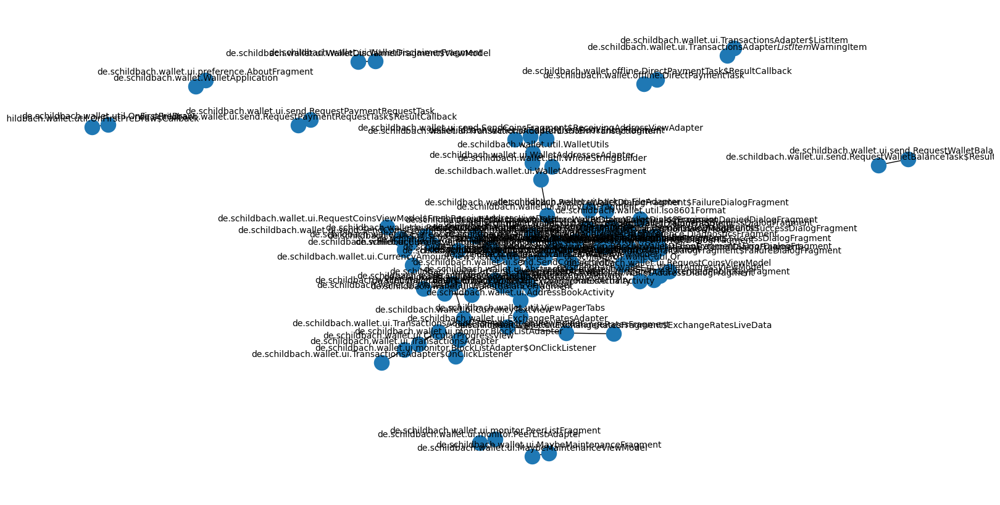

In [309]:
# Create a new graph
G_w_2 = nx.Graph()
    
# Add weighted edges to the graph
G_w_2.add_weighted_edges_from(weighted_edges_list_2)

draw_graph(G_w_2)
plt.show()

In [310]:
# Find connected components
connected_components_w_2 = [G_w_2.subgraph(c).copy() for c in nx.connected_components(G_w_2)]

list_sorted_connected_components(connected_components_w_2)

Feature 1: 76
Feature 2: 2
Feature 3: 2
Feature 4: 2
Feature 5: 2
Feature 6: 2
Feature 7: 2
Feature 8: 2
Feature 9: 2
Feature 10: 2
[['de.schildbach.wallet.ui.ExchangeRatesActivity', 'de.schildbach.wallet.ui.AbstractWalletActivity', 'de.schildbach.wallet.ui.RequestCoinsFragment', 'de.schildbach.wallet.ui.CurrencyCalculatorLink', 'de.schildbach.wallet.ui.WalletActivity', 'de.schildbach.wallet.ui.ReportIssueDialogFragment', 'de.schildbach.wallet.ui.HelpDialogFragment', 'de.schildbach.wallet.ui.DialogBuilder', 'de.schildbach.wallet.ui.scan.ScanActivity', 'de.schildbach.wallet.ui.scan.ScanActivity$WarnDialogFragment', 'de.schildbach.wallet.ui.send.SweepWalletActivity', 'de.schildbach.wallet.ui.preference.ExtendedPublicKeyFragment', 'de.schildbach.wallet.util.Qr', 'de.schildbach.wallet.ui.WalletAddressDialogFragment', 'de.schildbach.wallet.ui.TransactionsAdapter$TransactionViewHolder', 'de.schildbach.wallet.ui.CurrencyTextView', 'de.schildbach.wallet.ui.WalletAddressesFragment', 'de.schildb

## Community Detection

In [311]:
leiden_coms_w_2 = leiden_coms_detect(connected_components_w_2)

CONNECTED COMPONENTS 1
Average Internal Degree: FitnessResult(min=1.7142857142857142, max=2.1176470588235294, score=1.8991304855275444, std=0.13862571268479584)
Modularity Density: FitnessResult(min=None, max=None, score=11.018790849673202, std=None)
Communities Count: 8
Communities: [['de.schildbach.wallet.ui.HelpDialogFragment', 'de.schildbach.wallet.ui.DialogBuilder', 'de.schildbach.wallet.ui.AlertDialogsFragment', 'de.schildbach.wallet.ui.SendingAddressesFragment', 'de.schildbach.wallet.ui.backup.RestoreWalletDialogFragment$SuccessDialogFragment', 'de.schildbach.wallet.ui.ReportIssueDialogBuilder', 'de.schildbach.wallet.ui.backup.RestoreWalletFromExternalDialogFragment$FailureDialogFragment', 'de.schildbach.wallet.ui.backup.BackupWalletDialogFragment$ErrorDialogFragment', 'de.schildbach.wallet.ui.backup.RestoreWalletDialogFragment$PermissionDeniedDialogFragment', 'de.schildbach.wallet.ui.preference.DiagnosticsFragment', 'de.schildbach.wallet.ui.backup.RestoreWalletDialogFragment', 

In [312]:
# Refresh variable due to the bug in CDlib algorithm
connected_components_w_2 = [G_w_2.subgraph(c).copy() for c in nx.connected_components(G_w_2)]

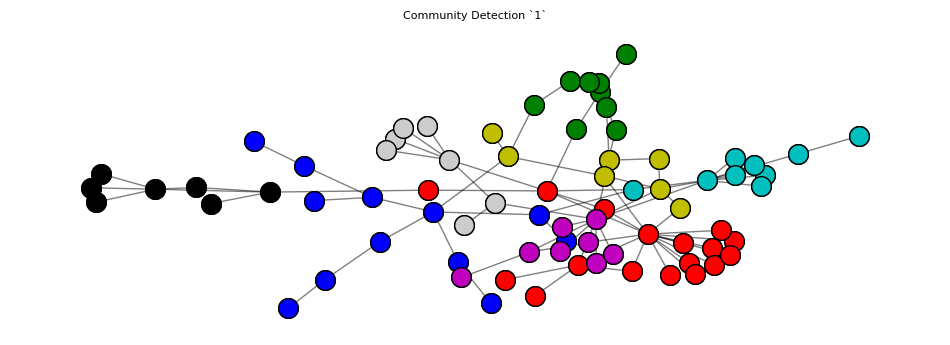

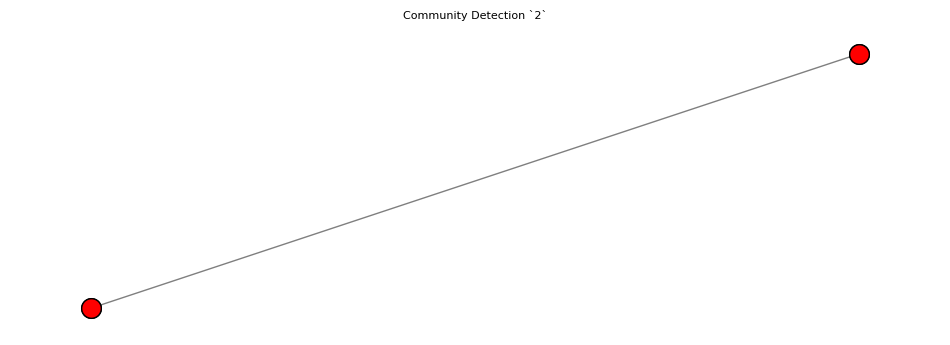

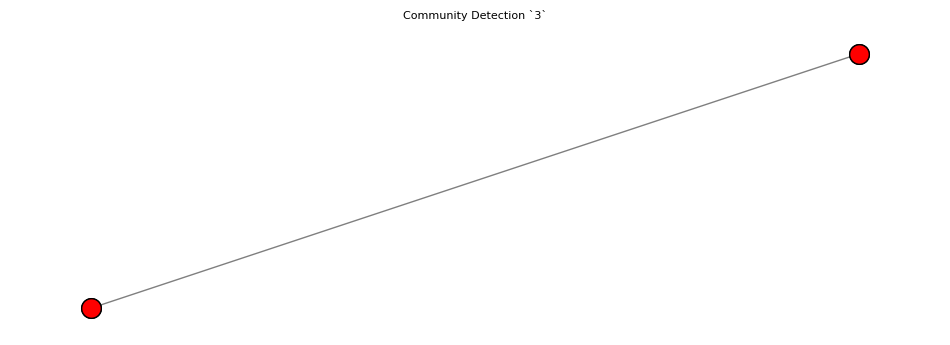

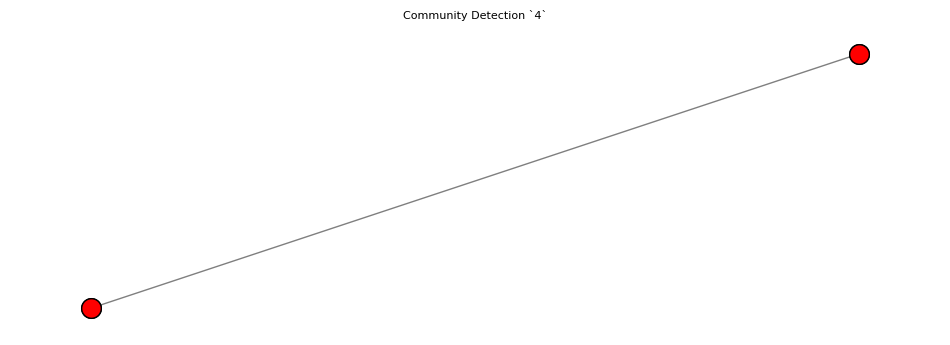

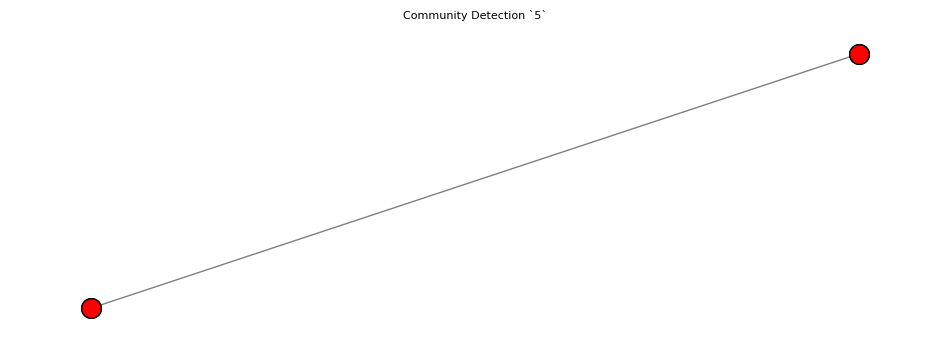

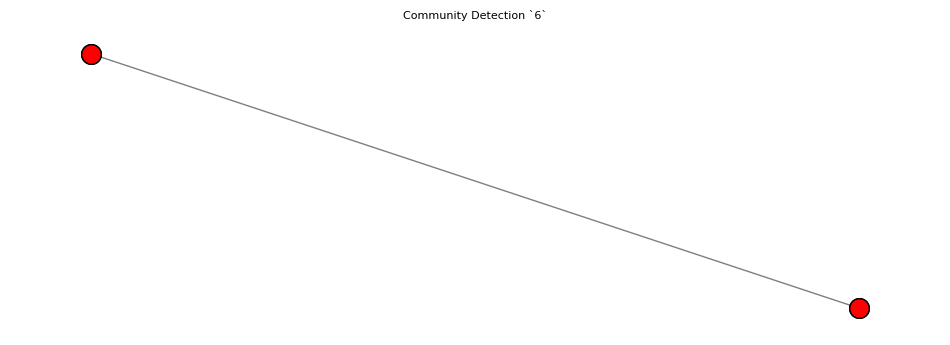

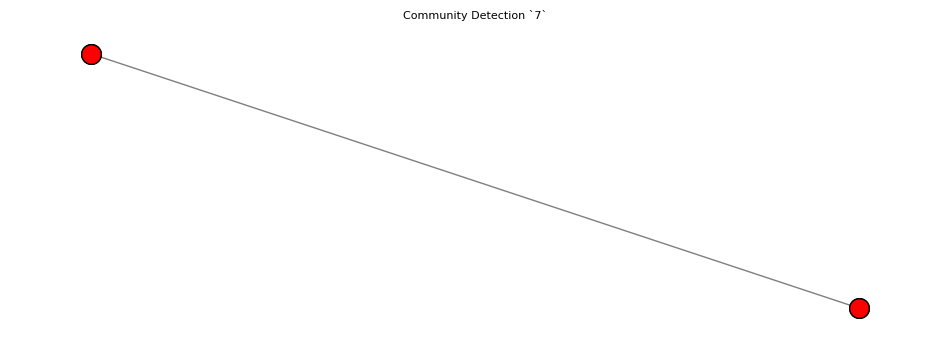

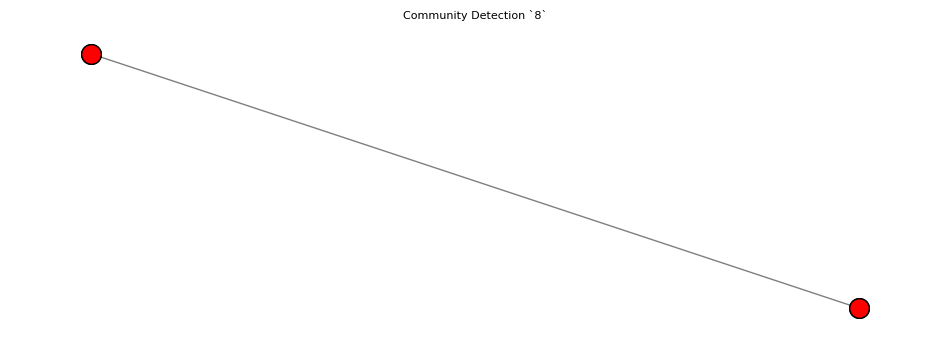

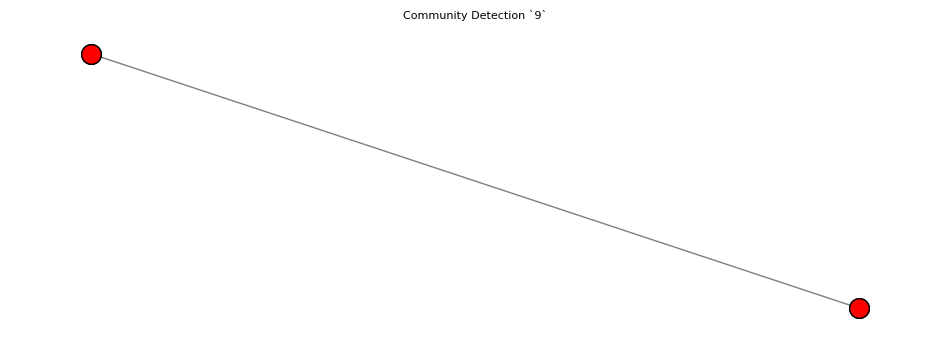

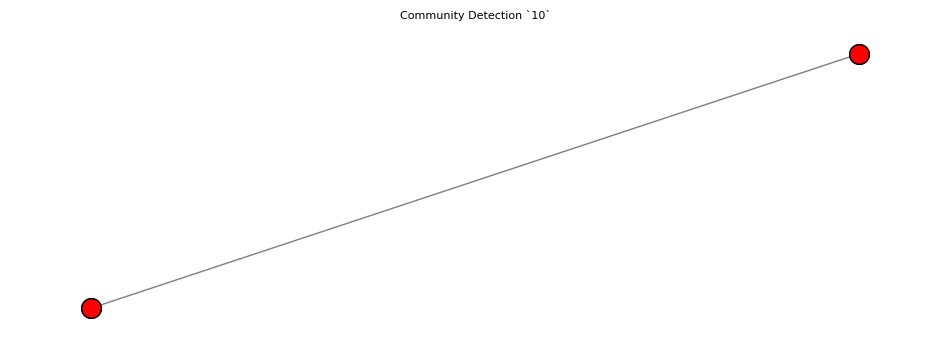

In [313]:
for i, coms in enumerate(leiden_coms_w_2):
    pos = nx.spring_layout(connected_components_w_2[i])
    viz.plot_network_clusters(connected_components_w_2[i], coms, pos, figsize=(12, 4))
    plt.title(f"Community Detection `{i+1}`", fontdict={'fontsize': 8})
    plt.show()

In [314]:
for i, coms in enumerate(leiden_coms_w_2):
    viz.plot_community_graph(connected_components_w_2[i], coms, figsize=(4, 4))
    plt.title(f"Community Graph `{i+1}`", fontdict={'fontsize': 8})
    plt.show()

KeyError: 'de.schildbach.wallet.ui.HelpDialogFragment'

## Feature Naming & Description

In [315]:
feat_hierarchy_2 = dict()           

for i in range(len(leiden_coms_w_2)):
    feat_hierarchy_2 = features_hierarchy(leiden_coms_w_2[i].communities, nodes_2, feat_hierarchy_2)

print(f'Features Count: {len(feat_hierarchy_2)}')
print(prettify_json(feat_hierarchy_2))

Features Count: 17
{
  "feature_1": {
    "feature_members": {
      "de.schildbach.wallet.ui.HelpDialogFragment": {
        "description": "This class is responsible for displaying a help dialog to the user within the application.",
        "roleStereotype": "User Interfacer",
        "layer": "Presentation Layer"
      },
      "de.schildbach.wallet.ui.DialogBuilder": {
        "description": "This class is responsible for creating and configuring dialog instances with customizable titles, messages, and icons for user interaction in an Android application.",
        "roleStereotype": "User Interfacer",
        "layer": "Presentation Layer"
      },
      "de.schildbach.wallet.ui.AlertDialogsFragment": {
        "description": "This class is responsible for managing and displaying various alert dialogs to inform users about important application states and settings.",
        "roleStereotype": "User Interfacer",
        "layer": "Presentation Layer"
      },
      "de.schildbach.walle

In [316]:
client_2 = setup_and_test_client(client_args_2, model_2)

https://api.openai.com/v1/
gpt-4o-mini
I’m called ChatGPT. How can I assist you today?


In [317]:
filename_2, timestr_2 = feature_batch_prompt(project_name_2, project_desc_2, model_2, nodes_2, feat_hierarchy_2)

Processing features: 100%|██████████| 17/17 [00:00<00:00, 1471.72it/s]


In [318]:
input_filepath_2 = f"2-Features-Identification-logs/{project_name_2}/{filename_2}.jsonl"

batch_request_2 = send_batch_request(client_2, input_filepath_2, f"{project_name_2}_features_batch_1024tokens")

batch_request_2

Batch(id='batch_GxJZLTdVk9KyBhCZ0fEekURu', completion_window='24h', created_at=1722193342, endpoint='/v1/chat/completions', input_file_id='file-z2aqDs6sTDsrgZRGmmy7FPRc', object='batch', status='validating', cancelled_at=None, cancelling_at=None, completed_at=None, error_file_id=None, errors=None, expired_at=None, expires_at=1722279742, failed_at=None, finalizing_at=None, in_progress_at=None, metadata={'description': 'Bitcoin Wallet (v6.31)_features_batch_1024tokens'}, output_file_id=None, request_counts=BatchRequestCounts(completed=0, failed=0, total=0))

In [338]:
batch_request_2 = client_2.batches.retrieve(batch_request_2.id)

batch_request_2

Batch(id='batch_GxJZLTdVk9KyBhCZ0fEekURu', completion_window='24h', created_at=1722193342, endpoint='/v1/chat/completions', input_file_id='file-z2aqDs6sTDsrgZRGmmy7FPRc', object='batch', status='completed', cancelled_at=None, cancelling_at=None, completed_at=1722193587, error_file_id=None, errors=None, expired_at=None, expires_at=1722279742, failed_at=None, finalizing_at=1722193586, in_progress_at=1722193343, metadata={'description': 'Bitcoin Wallet (v6.31)_features_batch_1024tokens'}, output_file_id='file-IS92Sumpq1blEamPP67bMuhO', request_counts=BatchRequestCounts(completed=17, failed=0, total=17))

In [339]:
file_response_2 = client_2.files.content(batch_request_2.output_file_id)

batch_output_filepath_2 = f'2-Features-Identification-logs/{project_name_2}/{project_name_2}-features-results-batch-{model_2}-{timestr_2}.jsonl'

merge_batch_output(batch_output_filepath_2, file_response_2.text)

feat_hierarchy_2 = get_result(batch_output_filepath_2, feat_hierarchy_2)

feat_hierarchy_2

{'feature_1': {'feature_name': 'userInteractionDialogs',
  'feature_description': 'This feature is responsible for managing user interactions through various dialog interfaces, including help, alerts, and wallet restoration processes, enhancing the overall user experience within the Bitcoin Wallet application.',
  'feature_members': {'de.schildbach.wallet.ui.HelpDialogFragment': {'description': 'This class is responsible for displaying a help dialog to the user within the application.',
    'roleStereotype': 'User Interfacer',
    'layer': 'Presentation Layer'},
   'de.schildbach.wallet.ui.DialogBuilder': {'description': 'This class is responsible for creating and configuring dialog instances with customizable titles, messages, and icons for user interaction in an Android application.',
    'roleStereotype': 'User Interfacer',
    'layer': 'Presentation Layer'},
   'de.schildbach.wallet.ui.AlertDialogsFragment': {'description': 'This class is responsible for managing and displaying var

In [340]:
feat_hierarchy_2 = add_method_hierarchy(nodes_2, hierarchy_2, feat_hierarchy_2)

feat_hierarchy_2

{'feature_1': {'feature_name': 'userInteractionDialogs',
  'feature_description': 'This feature is responsible for managing user interactions through various dialog interfaces, including help, alerts, and wallet restoration processes, enhancing the overall user experience within the Bitcoin Wallet application.',
  'feature_members': {'de.schildbach.wallet.ui.HelpDialogFragment': {'description': 'This class is responsible for displaying a help dialog to the user within the application.',
    'roleStereotype': 'User Interfacer',
    'layer': 'Presentation Layer',
    'class_members': {'de.schildbach.wallet.ui.HelpDialogFragment.de.schildbach.wallet.ui.HelpDialogFragment()': {'description': 'This method is a constructor for the HelpDialogFragment class, initializing a new instance of the HelpDialogFragment.',
      'reason': 'The constructor is provided to create instances of the HelpDialogFragment, which is essential for displaying help information to the user.',
      'howToUse': 'To us

In [341]:
write_to_json_file(feat_hierarchy_2, f'../test/output/2-Features-Identification/{project_name_2}-features-{model_2}-{timestr_2}.json')

---
# Case Study 3: K-9 Mail v5.304

In [320]:
project_name_3, project_desc_3, graph_3, nodes_3, edges_3, client_args_3, model_3 = setup('config-k9mail-v5.304.ini')

(project_name_3, project_desc_3)

('K-9 Mail (v5.304)', 'K-9 Mail is an open-source email client for Android.')

In [321]:
hierarchy_3, nodes_3 = elements_preparation(nodes_3, edges_3)

Methods count: 6119
Classes count: 803
Packages count: 55
Project hierarchy count: 55


In [322]:
hierarchy_3

{'com.fsck.k9': {'com.fsck.k9.Account': ['com.fsck.k9.Account.addCertificate(com.fsck.k9.activity.setup.AccountSetupCheckSettings$CheckDirection,java.security.cert.X509Certificate)',
   'com.fsck.k9.Account.allowRemoteSearch()',
   'com.fsck.k9.Account.cacheChips()',
   'com.fsck.k9.Account.com.fsck.k9.Account(android.content.Context)',
   'com.fsck.k9.Account.com.fsck.k9.Account(com.fsck.k9.Preferences,java.lang.String)',
   'com.fsck.k9.Account.delete(com.fsck.k9.Preferences)',
   'com.fsck.k9.Account.deleteCertificate(java.lang.String,int,com.fsck.k9.activity.setup.AccountSetupCheckSettings$CheckDirection)',
   'com.fsck.k9.Account.deleteCertificates()',
   'com.fsck.k9.Account.deleteIdentities(com.fsck.k9.preferences.Storage,com.fsck.k9.preferences.StorageEditor)',
   'com.fsck.k9.Account.equals(java.lang.Object)',
   'com.fsck.k9.Account.excludeSpecialFolder(com.fsck.k9.search.LocalSearch,java.lang.String)',
   'com.fsck.k9.Account.excludeSpecialFolders(com.fsck.k9.search.LocalSea

## Selecting User Interaction Components

In [323]:
p_layer_nodes_3, p_layer_edges_3 = presentation_layer_prep(nodes_3, edges_3)

len(p_layer_nodes_3), p_layer_nodes_3

(2053,
 ['com.fsck.k9.view.K9WebViewClient.newInstance(com.fsck.k9.mailstore.AttachmentResolver)',
  'com.fsck.k9.ui.messageview.MessageViewFragment.displayMessageSubject(java.lang.String)',
  'com.fsck.k9.fragment.MessageListFragment.decodeArguments()',
  'com.fsck.k9.activity.ActivityListener.synchronizeMailboxHeadersStarted(com.fsck.k9.Account,java.lang.String)',
  'com.fsck.k9.activity.compose.RecipientPresenter.onClickCcLabel()',
  'com.fsck.k9.ui.compose.QuotedMessageMvpView.setMessageContentCharacters(java.lang.String)',
  'com.fsck.k9.mailstore.MessageViewInfoExtractor.buildHtml(com.fsck.k9.mail.internet.Viewable,boolean)',
  'com.fsck.k9.activity.ManageIdentities.com.fsck.k9.activity.ManageIdentities()',
  'com.fsck.k9.activity.Accounts.showAccountsImportedDialog(com.fsck.k9.preferences.SettingsImporter$ImportResults,java.lang.String)',
  'com.fsck.k9.activity.K9ListActivity.onCreate(android.os.Bundle)',
  'com.fsck.k9.activity.MessageCompose.onProgressCancel(com.fsck.k9.fragm

In [324]:
len(p_layer_edges_3), p_layer_edges_3

(3451,
 [{'id': 'c29d749418fde4560010a23a9a360668',
   'source': 'com.fsck.k9.fragment',
   'label': 'contains',
   'properties': {'weight': 1, 'metaSrc': 'source code'},
   'target': 'com.fsck.k9.fragment.MessageListFragment$MessageListActivityListener'},
  {'id': '4206d34e678696520d539790102429fb',
   'source': 'com.fsck.k9.view',
   'label': 'contains',
   'properties': {'weight': 1, 'metaSrc': 'source code'},
   'target': 'com.fsck.k9.view.ThemeUtils'},
  {'id': '3490e44b5b1d03d3e88439dc8beda925',
   'source': 'com.fsck.k9.activity.compose',
   'label': 'contains',
   'properties': {'weight': 1, 'metaSrc': 'source code'},
   'target': 'com.fsck.k9.activity.compose.IdentityAdapter$IdentityHolder'},
  {'id': '19287d5288aa591683b8d2ab70b57f67',
   'source': 'com.fsck.k9.view',
   'label': 'contains',
   'properties': {'weight': 1, 'metaSrc': 'source code'},
   'target': 'com.fsck.k9.view.MessageTitleView'},
  {'id': '4efffd34464fe96182bc57e9b853723f',
   'source': 'com.fsck.k9.activit

In [325]:
lifted_edges_3 = p_layer_edges_prep(p_layer_edges_3, edges_3)

len(lifted_edges_3), lifted_edges_3

(343,
 [{'source': 'com.fsck.k9.activity.compose.MessageActions',
   'target': 'com.fsck.k9.activity.compose.MessageActions',
   'label': 'hasScript-invokes-inv_hasScript',
   'properties': {'weight': 1}},
  {'source': 'com.fsck.k9.activity.setup.AuthTypeHolder',
   'target': 'com.fsck.k9.activity.setup.AuthTypeHolder',
   'label': 'hasScript-invokes-inv_hasScript',
   'properties': {'weight': 1}},
  {'source': 'com.fsck.k9.ui.messageview.MessageTopView',
   'target': 'com.fsck.k9.ui.messageview.MessageTopView',
   'label': 'hasScript-invokes-inv_hasScript',
   'properties': {'weight': 11}},
  {'source': 'com.fsck.k9.activity.FolderList$FolderListAdapter',
   'target': 'com.fsck.k9.Account',
   'label': 'hasScript-invokes-inv_hasScript',
   'properties': {'weight': 2}},
  {'source': 'com.fsck.k9.fragment.AttachmentDownloadDialogFragment',
   'target': 'com.fsck.k9.fragment.AttachmentDownloadDialogFragment$AttachmentDownloadCancelListener',
   'label': 'hasScript-invokes-inv_hasScript',

In [326]:
lifted_edges_3 = remove_self_calling_edges(lifted_edges_3)

len(lifted_edges_3), lifted_edges_3

(243,
 [{'source': 'com.fsck.k9.activity.FolderList$FolderListAdapter',
   'target': 'com.fsck.k9.Account',
   'label': 'hasScript-invokes-inv_hasScript',
   'properties': {'weight': 2}},
  {'source': 'com.fsck.k9.fragment.AttachmentDownloadDialogFragment',
   'target': 'com.fsck.k9.fragment.AttachmentDownloadDialogFragment$AttachmentDownloadCancelListener',
   'label': 'hasScript-invokes-inv_hasScript',
   'properties': {'weight': 1}},
  {'source': 'com.fsck.k9.ui.messageview.MessageTopView',
   'target': 'com.fsck.k9.view.ToolableViewAnimator',
   'label': 'hasScript-invokes-inv_hasScript',
   'properties': {'weight': 4}},
  {'source': 'com.fsck.k9.notification.BaseNotifications',
   'target': 'com.fsck.k9.notification.NotificationActionCreator',
   'label': 'hasScript-invokes-inv_hasScript',
   'properties': {'weight': 1}},
  {'source': 'com.fsck.k9.ui.messageview.MessageContainerView',
   'target': 'com.fsck.k9.view.MessageWebView',
   'label': 'hasScript-invokes-inv_hasScript',
  

In [327]:
weighted_edges_list_3 = weighted_edges_prep(lifted_edges_3)

len(weighted_edges_list_3), weighted_edges_list_3

(243,
 [('com.fsck.k9.activity.FolderList$FolderListAdapter',
   'com.fsck.k9.Account',
   2),
  ('com.fsck.k9.fragment.AttachmentDownloadDialogFragment',
   'com.fsck.k9.fragment.AttachmentDownloadDialogFragment$AttachmentDownloadCancelListener',
   1),
  ('com.fsck.k9.ui.messageview.MessageTopView',
   'com.fsck.k9.view.ToolableViewAnimator',
   4),
  ('com.fsck.k9.notification.BaseNotifications',
   'com.fsck.k9.notification.NotificationActionCreator',
   1),
  ('com.fsck.k9.ui.messageview.MessageContainerView',
   'com.fsck.k9.view.MessageWebView',
   6),
  ('com.fsck.k9.ui.messageview.AttachmentController$SaveAttachmentAsyncTask',
   'com.fsck.k9.ui.messageview.MessageViewFragment',
   2),
  ('com.fsck.k9.activity.compose.RecipientAdapter',
   'com.fsck.k9.view.RecipientSelectView$Recipient',
   1),
  ('com.fsck.k9.activity.MessageList',
   'com.fsck.k9.fragment.MessageListFragment',
   9),
  ('com.fsck.k9.ui.messageview.MessageViewFragment',
   'com.fsck.k9.ui.messageview.Message

## Connected Components

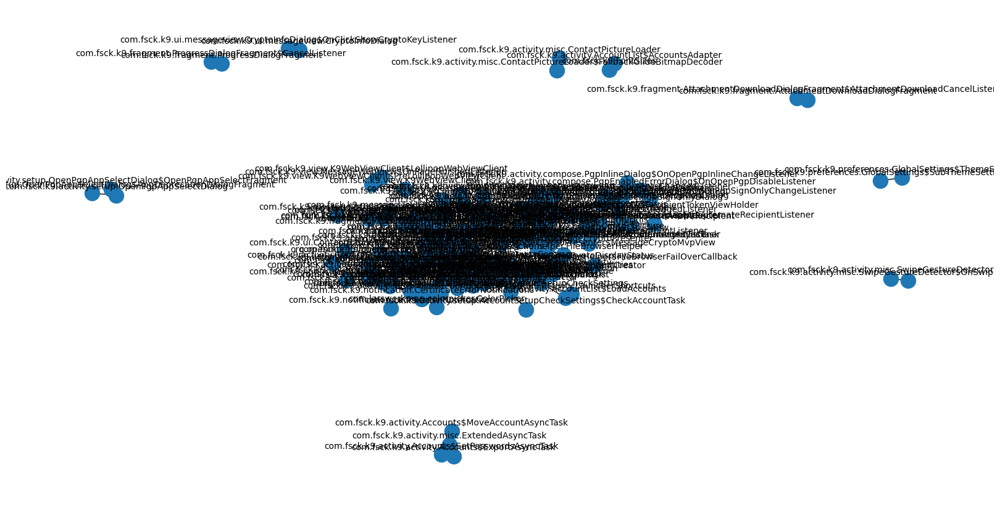

In [328]:
# Create a new graph
G_w_3 = nx.Graph()
    
# Add weighted edges to the graph
G_w_3.add_weighted_edges_from(weighted_edges_list_3)

draw_graph(G_w_3)
plt.show()

In [329]:
# Find connected components
connected_components_w_3 = [G_w_3.subgraph(c).copy() for c in nx.connected_components(G_w_3)]

list_sorted_connected_components(connected_components_w_3)

Feature 1: 155
Feature 2: 4
Feature 3: 3
Feature 4: 2
Feature 5: 2
Feature 6: 2
Feature 7: 2
Feature 8: 2
Feature 9: 2
Feature 10: 2
[['com.fsck.k9.activity.FolderList$FolderListAdapter', 'com.fsck.k9.Account', 'com.fsck.k9.ui.messageview.MessageTopView', 'com.fsck.k9.view.ToolableViewAnimator', 'com.fsck.k9.notification.BaseNotifications', 'com.fsck.k9.notification.NotificationActionCreator', 'com.fsck.k9.ui.messageview.MessageContainerView', 'com.fsck.k9.view.MessageWebView', 'com.fsck.k9.ui.messageview.AttachmentController$SaveAttachmentAsyncTask', 'com.fsck.k9.ui.messageview.MessageViewFragment', 'com.fsck.k9.activity.compose.RecipientAdapter', 'com.fsck.k9.view.RecipientSelectView$Recipient', 'com.fsck.k9.activity.MessageList', 'com.fsck.k9.fragment.MessageListFragment', 'com.fsck.k9.ui.messageview.MessageCryptoPresenter', 'com.fsck.k9.notification.SyncNotifications', 'com.fsck.k9.activity.setup.AccountSetupNames', 'com.fsck.k9.activity.Accounts', 'com.fsck.k9.activity.setup.Accou

## Community Detection

In [330]:
leiden_coms_w_3 = leiden_coms_detect(connected_components_w_3)

CONNECTED COMPONENTS 1
Average Internal Degree: FitnessResult(min=1.6666666666666667, max=2.588235294117647, score=2.1833184789067146, std=0.3167593472903207)
Modularity Density: FitnessResult(min=None, max=None, score=17.094771241830063, std=None)
Communities Count: 11
Communities: [['com.fsck.k9.activity.compose.RecipientAdapter', 'com.fsck.k9.view.RecipientSelectView$Recipient', 'com.fsck.k9.activity.compose.RecipientMvpView', 'com.fsck.k9.view.RecipientSelectView', 'com.fsck.k9.activity.AlternateRecipientAdapter', 'com.fsck.k9.activity.compose.PgpInlineDialog', 'com.fsck.k9.activity.compose.PgpInlineDialog$OnOpenPgpInlineChangeListener', 'com.fsck.k9.activity.compose.PgpSignOnlyDialog', 'com.fsck.k9.view.ThemeUtils', 'com.fsck.k9.activity.compose.PgpEncryptDescriptionDialog', 'com.fsck.k9.view.HighlightDialogFragment', 'com.fsck.k9.activity.compose.PgpSignOnlyDialog$OnOpenPgpSignOnlyChangeListener', 'com.fsck.k9.activity.AlternateRecipientAdapter$AlternateRecipientListener', 'com.f

In [331]:
# Refresh variable due to the bug in CDlib algorithm
connected_components_w_3 = [G_w_3.subgraph(c).copy() for c in nx.connected_components(G_w_3)]

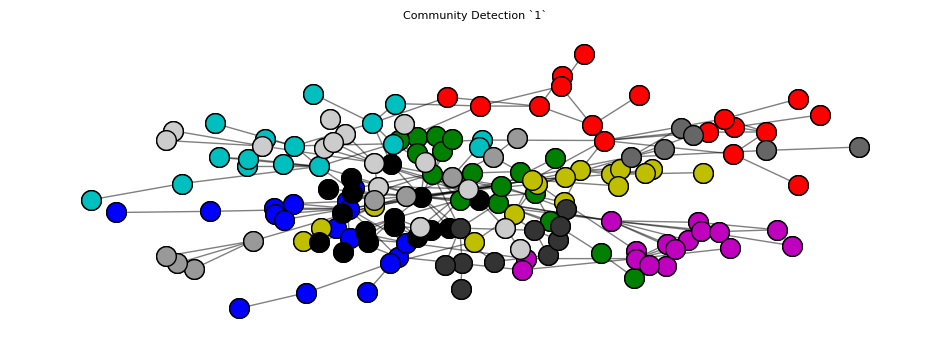

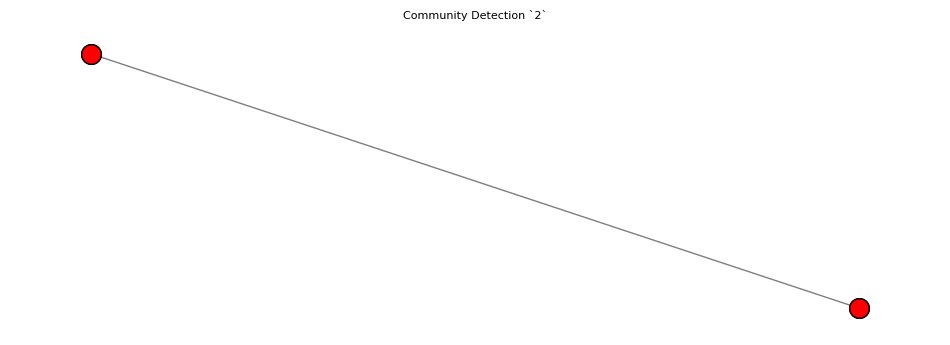

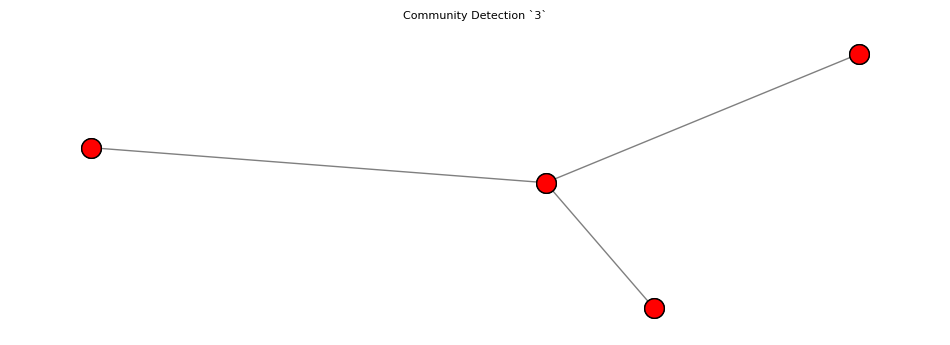

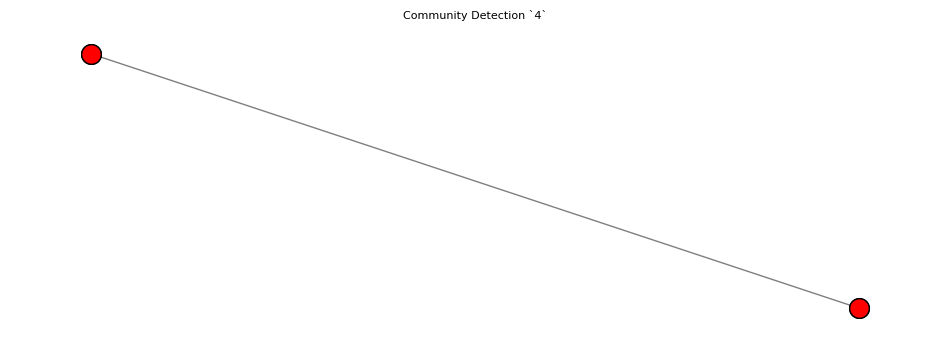

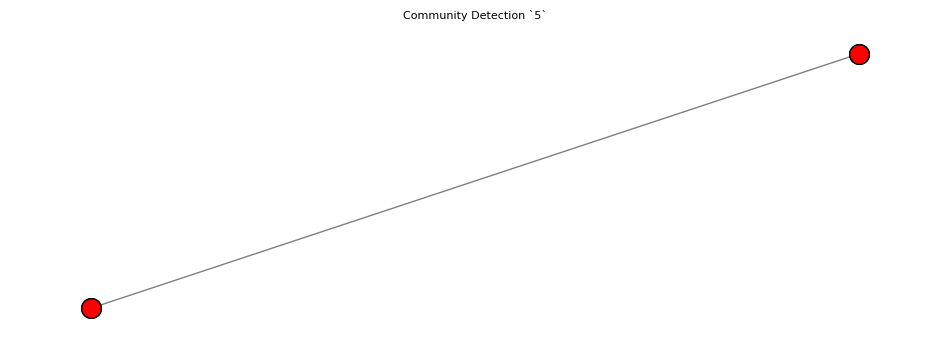

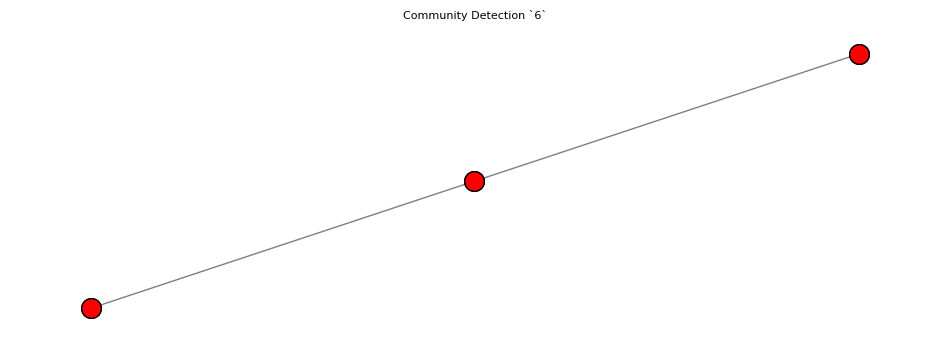

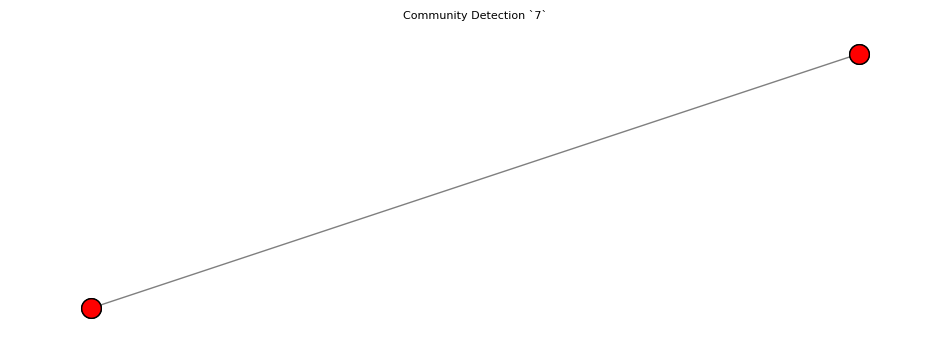

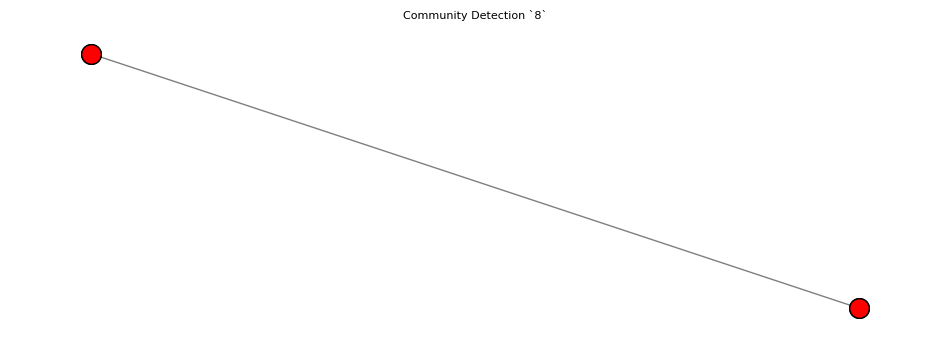

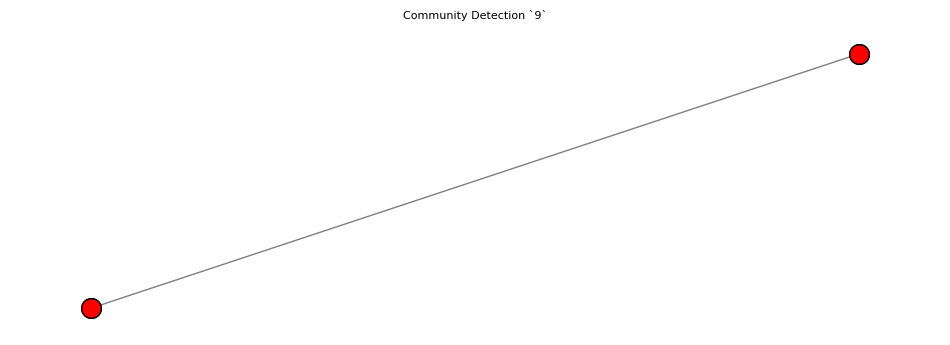

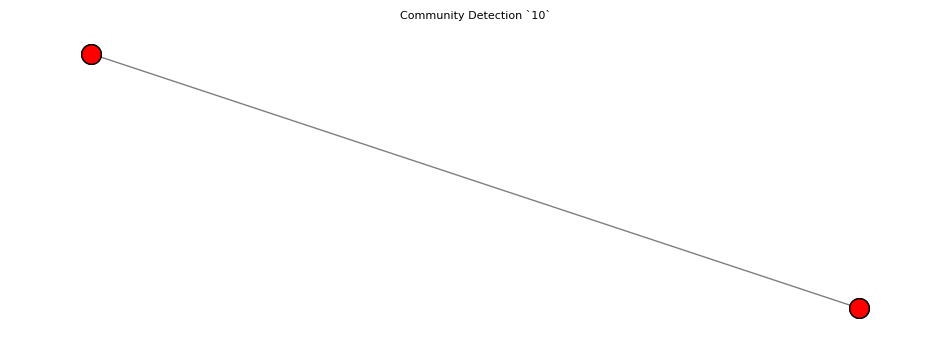

In [332]:
for i, coms in enumerate(leiden_coms_w_3):
    pos = nx.spring_layout(connected_components_w_3[i])
    viz.plot_network_clusters(connected_components_w_3[i], coms, pos, figsize=(12, 4))
    plt.title(f"Community Detection `{i+1}`", fontdict={'fontsize': 8})
    plt.show()

In [333]:
for i, coms in enumerate(leiden_coms_w_3):
    viz.plot_community_graph(connected_components_w_3[i], coms, figsize=(4, 4))
    plt.title(f"Community Graph `{i+1}`", fontdict={'fontsize': 8})
    plt.show()

KeyError: 'com.fsck.k9.activity.compose.RecipientAdapter'

## Feature Naming & Description

In [334]:
feat_hierarchy_3 = dict()           

for i in range(len(leiden_coms_w_3)):
    feat_hierarchy_3 = features_hierarchy(leiden_coms_w_3[i].communities, nodes_3, feat_hierarchy_3)

print(f'Features Count: {len(feat_hierarchy_3)}')
print(prettify_json(feat_hierarchy_3))

Features Count: 20
{
  "feature_1": {
    "feature_members": {
      "com.fsck.k9.activity.compose.RecipientAdapter": {
        "description": "The class is responsible for managing and displaying recipient information in the email composition interface of the K-9 Mail application.",
        "roleStereotype": "User Interfacer",
        "layer": "Presentation Layer"
      },
      "com.fsck.k9.view.RecipientSelectView$Recipient": {
        "description": "This class is responsible for encapsulating recipient information, including email addresses and associated metadata, for use within the email client.",
        "roleStereotype": "Information Holder",
        "layer": "Domain Layer"
      },
      "com.fsck.k9.activity.compose.RecipientMvpView": {
        "description": "This class is responsible for managing the user interface components related to email recipient input in the email composition process.",
        "roleStereotype": "User Interfacer",
        "layer": "Presentation Laye

In [335]:
client_3 = setup_and_test_client(client_args_3, model_3)

https://api.openai.com/v1/
gpt-4o-mini
I’m called ChatGPT. How can I assist you today?


In [336]:
filename_3, timestr_3 = feature_batch_prompt(project_name_3, project_desc_3, model_3, nodes_3, feat_hierarchy_3)

Processing features: 100%|██████████| 20/20 [00:00<00:00, 1729.08it/s]


In [337]:
input_filepath_3 = f"2-Features-Identification-logs/{project_name_3}/{filename_3}.jsonl"

batch_request_3 = send_batch_request(client_3, input_filepath_3, f"{project_name_3}_features_batch_1024tokens")

batch_request_3

Batch(id='batch_wK1uAIXdYDaZqSH9Jrs2V1KZ', completion_window='24h', created_at=1722194082, endpoint='/v1/chat/completions', input_file_id='file-NET74DQgPded6UlKUa9F2yLb', object='batch', status='validating', cancelled_at=None, cancelling_at=None, completed_at=None, error_file_id=None, errors=None, expired_at=None, expires_at=1722280482, failed_at=None, finalizing_at=None, in_progress_at=None, metadata={'description': 'K-9 Mail (v5.304)_features_batch_1024tokens'}, output_file_id=None, request_counts=BatchRequestCounts(completed=0, failed=0, total=0))

In [378]:
batch_request_3 = client_3.batches.retrieve(batch_request_3.id)

batch_request_3

Batch(id='batch_wK1uAIXdYDaZqSH9Jrs2V1KZ', completion_window='24h', created_at=1722194082, endpoint='/v1/chat/completions', input_file_id='file-NET74DQgPded6UlKUa9F2yLb', object='batch', status='completed', cancelled_at=None, cancelling_at=None, completed_at=1722195148, error_file_id=None, errors=None, expired_at=None, expires_at=1722280482, failed_at=None, finalizing_at=1722195146, in_progress_at=1722194083, metadata={'description': 'K-9 Mail (v5.304)_features_batch_1024tokens'}, output_file_id='file-g2X4v7fpHr7CtQFFxgpCipxC', request_counts=BatchRequestCounts(completed=20, failed=0, total=20))

In [379]:
file_response_3 = client_3.files.content(batch_request_3.output_file_id)

batch_output_filepath_3 = f'2-Features-Identification-logs/{project_name_3}/{project_name_3}-features-results-batch-{model_3}-{timestr_3}.jsonl'

merge_batch_output(batch_output_filepath_3, file_response_3.text)

feat_hierarchy_3 = get_result(batch_output_filepath_3, feat_hierarchy_3)

feat_hierarchy_3

{'feature_1': {'feature_name': 'recipientManagement',
  'feature_description': 'This feature is responsible for managing the recipient selection and interaction process during email composition, allowing users to add, remove, and configure email recipients, including options for PGP encryption settings.',
  'feature_members': {'com.fsck.k9.activity.compose.RecipientAdapter': {'description': 'The class is responsible for managing and displaying recipient information in the email composition interface of the K-9 Mail application.',
    'roleStereotype': 'User Interfacer',
    'layer': 'Presentation Layer'},
   'com.fsck.k9.view.RecipientSelectView$Recipient': {'description': 'This class is responsible for encapsulating recipient information, including email addresses and associated metadata, for use within the email client.',
    'roleStereotype': 'Information Holder',
    'layer': 'Domain Layer'},
   'com.fsck.k9.activity.compose.RecipientMvpView': {'description': 'This class is respons

In [380]:
feat_hierarchy_3 = add_method_hierarchy(nodes_3, hierarchy_3, feat_hierarchy_3)

feat_hierarchy_3

{'feature_1': {'feature_name': 'recipientManagement',
  'feature_description': 'This feature is responsible for managing the recipient selection and interaction process during email composition, allowing users to add, remove, and configure email recipients, including options for PGP encryption settings.',
  'feature_members': {'com.fsck.k9.activity.compose.RecipientAdapter': {'description': 'The class is responsible for managing and displaying recipient information in the email composition interface of the K-9 Mail application.',
    'roleStereotype': 'User Interfacer',
    'layer': 'Presentation Layer',
    'class_members': {'com.fsck.k9.activity.compose.RecipientAdapter.bindCryptoAdvanced(com.fsck.k9.view.RecipientSelectView$Recipient,com.fsck.k9.activity.compose.RecipientAdapter$RecipientTokenHolder)': {'description': 'The method binds the cryptographic status of a recipient to the UI elements in the recipient selection view.',
      'reason': 'The method is provided to visually rep

In [381]:
write_to_json_file(feat_hierarchy_3, f'../test/output/2-Features-Identification/{project_name_3}-features-{model_3}-{timestr_3}.json')

---
# Case Study 4: Sweet Home 3D v5.6

In [342]:
project_name_4, project_desc_4, graph_4, nodes_4, edges_4, client_args_4, model_4 = setup('config-sweethome3d-v5.6.ini')

(project_name_4, project_desc_4)

('Sweet Home 3D (v5.6)',
 'Sweet Home 3D is an interior design application that helps you to quickly draw the floor plan of your house, arrange furniture on it, and visit the results in 3D.')

In [343]:
hierarchy_4, nodes_4 = elements_preparation(nodes_4, edges_4)

Methods count: 5907
Classes count: 576
Packages count: 9
Project hierarchy count: 9


In [344]:
hierarchy_4

{'com.eteks.sweethome3d': {'com.eteks.sweethome3d.HomeFrameController': ['com.eteks.sweethome3d.HomeFrameController.com.eteks.sweethome3d.HomeFrameController(com.eteks.sweethome3d.model.Home,com.eteks.sweethome3d.model.HomeApplication,com.eteks.sweethome3d.viewcontroller.ViewFactory,com.eteks.sweethome3d.viewcontroller.ContentManager,com.eteks.sweethome3d.plugin.PluginManager)',
   'com.eteks.sweethome3d.HomeFrameController.displayView()',
   'com.eteks.sweethome3d.HomeFrameController.getHomeController()',
   'com.eteks.sweethome3d.HomeFrameController.getView()'],
  'com.eteks.sweethome3d.HomeFramePane': ['com.eteks.sweethome3d.HomeFramePane.addListeners(com.eteks.sweethome3d.model.Home,com.eteks.sweethome3d.model.HomeApplication,com.eteks.sweethome3d.viewcontroller.HomeController,javax.swing.JFrame)',
   'com.eteks.sweethome3d.HomeFramePane.addWindowStateListener(com.eteks.sweethome3d.model.Home,com.eteks.sweethome3d.model.HomeApplication,com.eteks.sweethome3d.viewcontroller.HomeContr

## Selecting User Interaction Components

In [345]:
p_layer_nodes_4, p_layer_edges_4 = presentation_layer_prep(nodes_4, edges_4)

len(p_layer_nodes_4), p_layer_nodes_4

(2856,
 ['com.eteks.sweethome3d.viewcontroller.PolylineController$ModifiedPolyline.reset()',
  'com.eteks.sweethome3d.viewcontroller.PlanView.convertYModelToScreen(float)',
  'com.eteks.sweethome3d.viewcontroller.PlanController$RoomNameOffsetState.releaseMouse(float,float)',
  'com.eteks.sweethome3d.viewcontroller.PlanController.getResizedCompassAt(float,float)',
  'com.eteks.sweethome3d.j3d.Wall3D.updateFilledWallSideAppearance(javax.media.j3d.Appearance,com.eteks.sweethome3d.model.HomeTexture,boolean,java.lang.Integer,float)',
  'com.eteks.sweethome3d.viewcontroller.ViewFactoryAdapter.createWallView(com.eteks.sweethome3d.model.UserPreferences,com.eteks.sweethome3d.viewcontroller.WallController)',
  'com.eteks.sweethome3d.swing.PlanComponent.getWallPaint(float,java.awt.Color,java.awt.Color,com.eteks.sweethome3d.model.TextureImage)',
  'com.eteks.sweethome3d.swing.PhotoSizeAndQualityPanel$LanguageChangeListener',
  'com.eteks.sweethome3d.viewcontroller.HomeController$Update.getVersion(

In [346]:
len(p_layer_edges_4), p_layer_edges_4

(6077,
 [{'id': 'c89756a53e995ad16e4d42f28beec6e1',
   'source': 'com.eteks.sweethome3d.viewcontroller',
   'label': 'contains',
   'properties': {'weight': 1, 'metaSrc': 'source code'},
   'target': 'com.eteks.sweethome3d.viewcontroller.HomeView$ActionType'},
  {'id': '5cbb8ca33302d2c6034b2b549583a7d7',
   'source': 'com.eteks.sweethome3d.viewcontroller',
   'label': 'contains',
   'properties': {'weight': 1, 'metaSrc': 'source code'},
   'target': 'com.eteks.sweethome3d.viewcontroller.ImportedFurnitureWizardController$ImportedFurnitureWizardStepState'},
  {'id': '785145ad28e96729368bd90450fd33a7',
   'source': 'com.eteks.sweethome3d.applet',
   'label': 'contains',
   'properties': {'weight': 1, 'metaSrc': 'source code'},
   'target': 'com.eteks.sweethome3d.applet.SweetHome3DViewer'},
  {'id': '1db4344ecdc36a40730abfa64a28fd4a',
   'source': 'com.eteks.sweethome3d.swing',
   'label': 'contains',
   'properties': {'weight': 1, 'metaSrc': 'source code'},
   'target': 'com.eteks.sweetho

In [347]:
lifted_edges_4 = p_layer_edges_prep(p_layer_edges_4, edges_4)

len(lifted_edges_4), lifted_edges_4

(513,
 [{'source': 'com.eteks.sweethome3d.swing.FurnitureTable$FurnitureTreeTableModel',
   'target': 'com.eteks.sweethome3d.swing.FurnitureTable$FurnitureTreeTableModel',
   'label': 'hasScript-invokes-inv_hasScript',
   'properties': {'weight': 10}},
  {'source': 'com.eteks.sweethome3d.swing.FurnitureTable',
   'target': 'com.eteks.sweethome3d.swing.FurnitureTable',
   'label': 'hasScript-invokes-inv_hasScript',
   'properties': {'weight': 10}},
  {'source': 'com.eteks.sweethome3d.viewcontroller.ImportedFurnitureWizardController$FurnitureModelStepState',
   'target': 'com.eteks.sweethome3d.viewcontroller.WizardController',
   'label': 'hasScript-invokes-inv_hasScript',
   'properties': {'weight': 1}},
  {'source': 'com.eteks.sweethome3d.viewcontroller.PlanController$PolylineDrawingState',
   'target': 'com.eteks.sweethome3d.viewcontroller.PlanController',
   'label': 'hasScript-invokes-inv_hasScript',
   'properties': {'weight': 5}},
  {'source': 'com.eteks.sweethome3d.viewcontroller

In [348]:
lifted_edges_4 = remove_self_calling_edges(lifted_edges_4)

len(lifted_edges_4), lifted_edges_4

(388,
 [{'source': 'com.eteks.sweethome3d.viewcontroller.ImportedFurnitureWizardController$FurnitureModelStepState',
   'target': 'com.eteks.sweethome3d.viewcontroller.WizardController',
   'label': 'hasScript-invokes-inv_hasScript',
   'properties': {'weight': 1}},
  {'source': 'com.eteks.sweethome3d.viewcontroller.PlanController$PolylineDrawingState',
   'target': 'com.eteks.sweethome3d.viewcontroller.PlanController',
   'label': 'hasScript-invokes-inv_hasScript',
   'properties': {'weight': 5}},
  {'source': 'com.eteks.sweethome3d.viewcontroller.BackgroundImageWizardController$ImageChoiceStepState',
   'target': 'com.eteks.sweethome3d.viewcontroller.BackgroundImageWizardController',
   'label': 'hasScript-invokes-inv_hasScript',
   'properties': {'weight': 3}},
  {'source': 'com.eteks.sweethome3d.viewcontroller.PlanController',
   'target': 'com.eteks.sweethome3d.model.HomePieceOfFurniture',
   'label': 'hasScript-invokes-inv_hasScript',
   'properties': {'weight': 3}},
  {'source':

In [349]:
weighted_edges_list_4 = weighted_edges_prep(lifted_edges_4)

len(weighted_edges_list_4), weighted_edges_list_4

(388,
 [('com.eteks.sweethome3d.viewcontroller.ImportedFurnitureWizardController$FurnitureModelStepState',
   'com.eteks.sweethome3d.viewcontroller.WizardController',
   1),
  ('com.eteks.sweethome3d.viewcontroller.PlanController$PolylineDrawingState',
   'com.eteks.sweethome3d.viewcontroller.PlanController',
   5),
  ('com.eteks.sweethome3d.viewcontroller.BackgroundImageWizardController$ImageChoiceStepState',
   'com.eteks.sweethome3d.viewcontroller.BackgroundImageWizardController',
   3),
  ('com.eteks.sweethome3d.viewcontroller.PlanController',
   'com.eteks.sweethome3d.model.HomePieceOfFurniture',
   3),
  ('com.eteks.sweethome3d.swing.ImportedTextureWizardStepsPanel',
   'com.eteks.sweethome3d.viewcontroller.ImportedTextureWizardController',
   10),
  ('com.eteks.sweethome3d.viewcontroller.PlanController$CameraYawRotationState',
   'com.eteks.sweethome3d.viewcontroller.PlanView',
   2),
  ('com.eteks.sweethome3d.viewcontroller.LevelController',
   'com.eteks.sweethome3d.viewcontro

## Connected Components

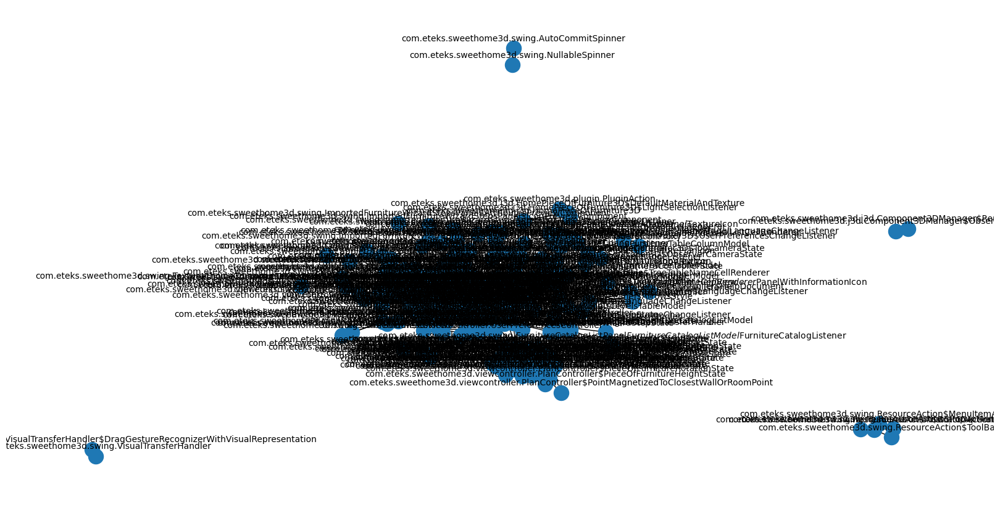

In [350]:
# Create a new graph
G_w_4 = nx.Graph()
    
# Add weighted edges to the graph
G_w_4.add_weighted_edges_from(weighted_edges_list_4)

draw_graph(G_w_4)
plt.show()

In [351]:
# Find connected components
connected_components_w_4 = [G_w_4.subgraph(c).copy() for c in nx.connected_components(G_w_4)]

list_sorted_connected_components(connected_components_w_4)

Feature 1: 231
Feature 2: 5
Feature 3: 2
Feature 4: 2
Feature 5: 2
[['com.eteks.sweethome3d.viewcontroller.ImportedFurnitureWizardController$FurnitureModelStepState', 'com.eteks.sweethome3d.viewcontroller.WizardController', 'com.eteks.sweethome3d.viewcontroller.PlanController$PolylineDrawingState', 'com.eteks.sweethome3d.viewcontroller.PlanController', 'com.eteks.sweethome3d.viewcontroller.BackgroundImageWizardController$ImageChoiceStepState', 'com.eteks.sweethome3d.viewcontroller.BackgroundImageWizardController', 'com.eteks.sweethome3d.model.HomePieceOfFurniture', 'com.eteks.sweethome3d.swing.ImportedTextureWizardStepsPanel', 'com.eteks.sweethome3d.viewcontroller.ImportedTextureWizardController', 'com.eteks.sweethome3d.viewcontroller.PlanController$CameraYawRotationState', 'com.eteks.sweethome3d.viewcontroller.PlanView', 'com.eteks.sweethome3d.viewcontroller.LevelController', 'com.eteks.sweethome3d.viewcontroller.DialogView', 'com.eteks.sweethome3d.viewcontroller.PlanController$PieceO

## Community Detection

In [352]:
leiden_coms_w_4 = leiden_coms_detect(connected_components_w_4)

CONNECTED COMPONENTS 1
Average Internal Degree: FitnessResult(min=1.6, max=3.4583333333333335, score=2.163826530612245, std=0.5272339245020362)
Modularity Density: FitnessResult(min=None, max=None, score=18.80321428571429, std=None)
Communities Count: 14
Communities: [['com.eteks.sweethome3d.viewcontroller.PlanController$PolylineDrawingState', 'com.eteks.sweethome3d.viewcontroller.PlanController', 'com.eteks.sweethome3d.viewcontroller.PlanController$CameraYawRotationState', 'com.eteks.sweethome3d.viewcontroller.PlanView', 'com.eteks.sweethome3d.viewcontroller.PlanController$PieceOfFurnitureResizeState', 'com.eteks.sweethome3d.viewcontroller.PlanController$SelectionMoveState', 'com.eteks.sweethome3d.viewcontroller.PlanController$PieceOfFurnitureRotationState', 'com.eteks.sweethome3d.viewcontroller.PlanController$PieceOfFurnitureElevationState', 'com.eteks.sweethome3d.viewcontroller.PlanController$PolylineCreationState', 'com.eteks.sweethome3d.viewcontroller.PlanController$WallResizeStat

In [353]:
# Refresh variable due to the bug in CDlib algorithm
connected_components_w_4 = [G_w_4.subgraph(c).copy() for c in nx.connected_components(G_w_4)]

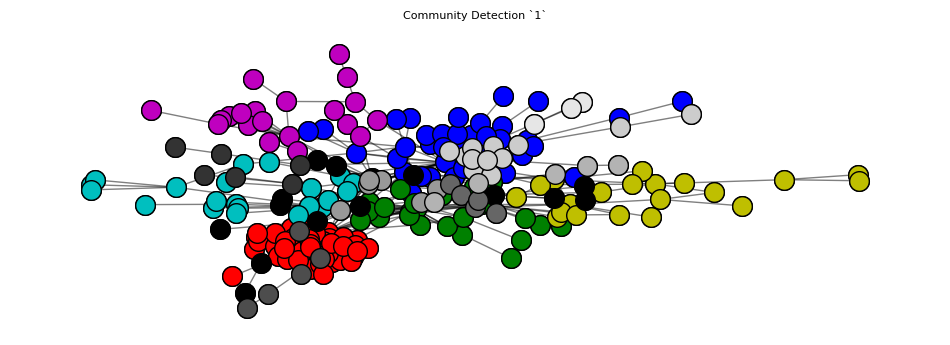

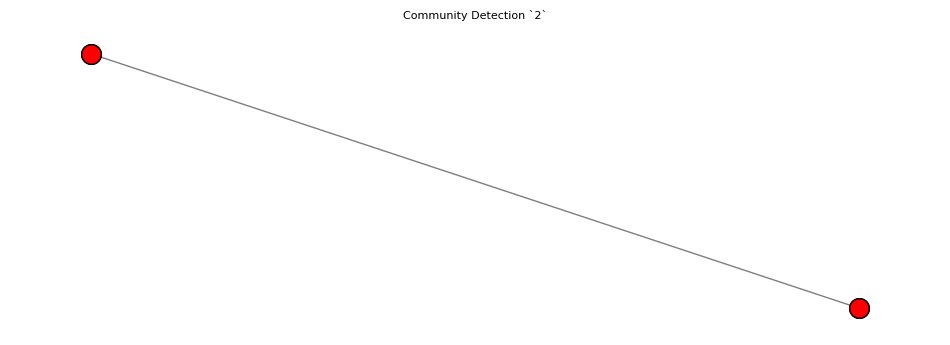

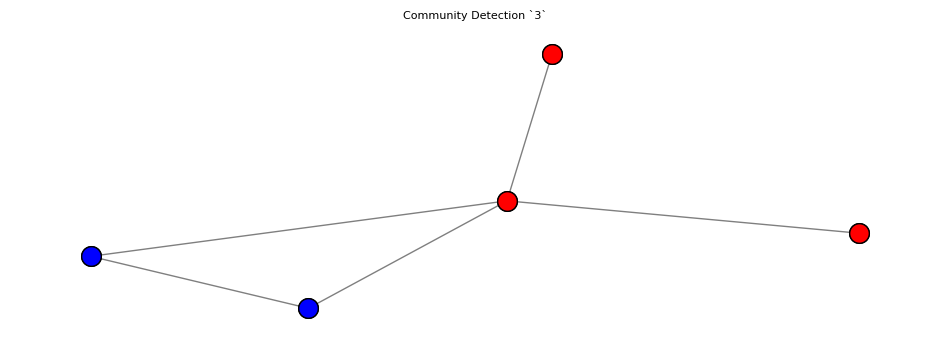

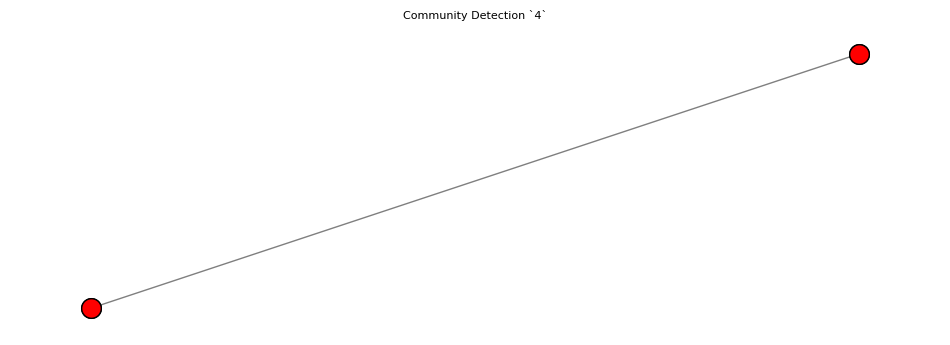

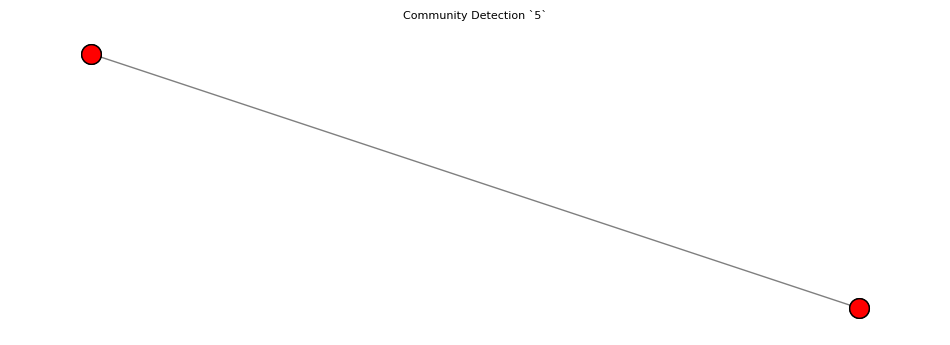

In [354]:
for i, coms in enumerate(leiden_coms_w_4):
    pos = nx.spring_layout(connected_components_w_4[i])
    viz.plot_network_clusters(connected_components_w_4[i], coms, pos, figsize=(12, 4))
    plt.title(f"Community Detection `{i+1}`", fontdict={'fontsize': 8})
    plt.show()

In [355]:
for i, coms in enumerate(leiden_coms_w_4):
    viz.plot_community_graph(connected_components_w_4[i], coms, figsize=(4, 4))
    plt.title(f"Community Graph `{i+1}`", fontdict={'fontsize': 8})
    plt.show()

KeyError: 'com.eteks.sweethome3d.viewcontroller.PlanController$PolylineDrawingState'

## Feature Naming & Description

In [356]:
feat_hierarchy_4 = dict()           

for i in range(len(leiden_coms_w_4)):
    feat_hierarchy_4 = features_hierarchy(leiden_coms_w_4[i].communities, nodes_4, feat_hierarchy_4)

print(f'Features Count: {len(feat_hierarchy_4)}')
print(prettify_json(feat_hierarchy_4))

Features Count: 19
{
  "feature_1": {
    "feature_members": {
      "com.eteks.sweethome3d.viewcontroller.PlanController$PolylineDrawingState": {
        "description": "This class is responsible for managing the state and behavior of polyline drawing within the application's user interface.",
        "roleStereotype": "Controller",
        "layer": "Presentation Layer"
      },
      "com.eteks.sweethome3d.viewcontroller.PlanController": {
        "description": "This class is responsible for managing the interactions and operations related to the floor plan, including adding, modifying, and deleting various elements such as furniture, walls, and labels.",
        "roleStereotype": "Controller",
        "layer": "Service Layer"
      },
      "com.eteks.sweethome3d.viewcontroller.PlanController$CameraYawRotationState": {
        "description": "This class is responsible for managing the camera's yaw rotation state during user interactions in the interior design application.",
       

In [357]:
client_4 = setup_and_test_client(client_args_4, model_4)

https://api.openai.com/v1/
gpt-4o-mini
I’m called ChatGPT. How can I assist you today?


In [358]:
filename_4, timestr_4 = feature_batch_prompt(project_name_4, project_desc_4, model_4, nodes_4, feat_hierarchy_4)

Processing features: 100%|██████████| 19/19 [00:00<00:00, 1304.60it/s]


In [359]:
input_filepath_4 = f"2-Features-Identification-logs/{project_name_4}/{filename_4}.jsonl"

batch_request_4 = send_batch_request(client_4, input_filepath_4, f"{project_name_4}_features_batch_1024tokens")

batch_request_4

Batch(id='batch_NUCslTXBSFikfEVSQ5kD9KEn', completion_window='24h', created_at=1722194746, endpoint='/v1/chat/completions', input_file_id='file-kfr1YsEQs0gMYO0fBNXJMrg2', object='batch', status='validating', cancelled_at=None, cancelling_at=None, completed_at=None, error_file_id=None, errors=None, expired_at=None, expires_at=1722281146, failed_at=None, finalizing_at=None, in_progress_at=None, metadata={'description': 'Sweet Home 3D (v5.6)_features_batch_1024tokens'}, output_file_id=None, request_counts=BatchRequestCounts(completed=0, failed=0, total=0))

In [382]:
batch_request_4 = client_4.batches.retrieve(batch_request_4.id)

batch_request_4

Batch(id='batch_NUCslTXBSFikfEVSQ5kD9KEn', completion_window='24h', created_at=1722194746, endpoint='/v1/chat/completions', input_file_id='file-kfr1YsEQs0gMYO0fBNXJMrg2', object='batch', status='completed', cancelled_at=None, cancelling_at=None, completed_at=1722195840, error_file_id=None, errors=None, expired_at=None, expires_at=1722281146, failed_at=None, finalizing_at=1722195839, in_progress_at=1722194747, metadata={'description': 'Sweet Home 3D (v5.6)_features_batch_1024tokens'}, output_file_id='file-ATSssoO1PktlFo3WA0yaHeEz', request_counts=BatchRequestCounts(completed=19, failed=0, total=19))

In [383]:
file_response_4 = client_4.files.content(batch_request_4.output_file_id)

batch_output_filepath_4 = f'2-Features-Identification-logs/{project_name_4}/{project_name_4}-features-results-batch-{model_4}-{timestr_4}.jsonl'

merge_batch_output(batch_output_filepath_4, file_response_4.text)

feat_hierarchy_4 = get_result(batch_output_filepath_4, feat_hierarchy_4)

feat_hierarchy_4

{'feature_1': {'feature_name': 'userInteractionManagement',
  'feature_description': 'This feature is responsible for managing various user interactions related to the creation, modification, and manipulation of elements within the floor plan, including furniture, walls, labels, and dimensions, enhancing the interior design experience.',
  'feature_members': {'com.eteks.sweethome3d.viewcontroller.PlanController$PolylineDrawingState': {'description': "This class is responsible for managing the state and behavior of polyline drawing within the application's user interface.",
    'roleStereotype': 'Controller',
    'layer': 'Presentation Layer'},
   'com.eteks.sweethome3d.viewcontroller.PlanController': {'description': 'This class is responsible for managing the interactions and operations related to the floor plan, including adding, modifying, and deleting various elements such as furniture, walls, and labels.',
    'roleStereotype': 'Controller',
    'layer': 'Service Layer'},
   'com.e

In [384]:
feat_hierarchy_4 = add_method_hierarchy(nodes_4, hierarchy_4, feat_hierarchy_4)

feat_hierarchy_4

{'feature_1': {'feature_name': 'userInteractionManagement',
  'feature_description': 'This feature is responsible for managing various user interactions related to the creation, modification, and manipulation of elements within the floor plan, including furniture, walls, labels, and dimensions, enhancing the interior design experience.',
  'feature_members': {'com.eteks.sweethome3d.viewcontroller.PlanController$PolylineDrawingState': {'description': "This class is responsible for managing the state and behavior of polyline drawing within the application's user interface.",
    'roleStereotype': 'Controller',
    'layer': 'Presentation Layer',
    'class_members': {'com.eteks.sweethome3d.viewcontroller.PlanController$PolylineDrawingState.com.eteks.sweethome3d.viewcontroller.PlanController$PolylineDrawingState()': {'description': 'The method is a constructor for the PolylineDrawingState class, initializing a new instance of this state without any specific parameters.',
      'reason': 'T

In [385]:
write_to_json_file(feat_hierarchy_4, f'../test/output/2-Features-Identification/{project_name_4}-features-{model_4}-{timestr_4}.json')

---
# Case Study 5: Apache Dubbo v3.2.14

In [360]:
project_name_5, project_desc_5, graph_5, nodes_5, edges_5, client_args_5, model_5 = setup('config-dubbo-v3.2.14.ini')

(project_name_5, project_desc_5)

('Apache Dubbo (v3.2.14)',
 'Apache Dubbo is a high-performance, Java-based open-source RPC (Remote Procedure Call) framework.')

In [361]:
hierarchy_5, nodes_5 = elements_preparation(nodes_5, edges_5)

Methods count: 17157
Classes count: 2140
Packages count: 402
Project hierarchy count: 402


In [362]:
hierarchy_5

{'com.alibaba.dubbo.cache': {'com.alibaba.dubbo.cache.CacheFactory': ['com.alibaba.dubbo.cache.CacheFactory.getCache(com.alibaba.dubbo.common.URL,com.alibaba.dubbo.rpc.Invocation)',
   'com.alibaba.dubbo.cache.CacheFactory.getCache(org.apache.dubbo.common.URL,org.apache.dubbo.rpc.Invocation)']},
 'com.alibaba.dubbo.cache.support': {'com.alibaba.dubbo.cache.support.AbstractCacheFactory': ['com.alibaba.dubbo.cache.support.AbstractCacheFactory.com.alibaba.dubbo.cache.support.AbstractCacheFactory()',
   'com.alibaba.dubbo.cache.support.AbstractCacheFactory.createCache(com.alibaba.dubbo.common.URL)',
   'com.alibaba.dubbo.cache.support.AbstractCacheFactory.getCache(com.alibaba.dubbo.common.URL,com.alibaba.dubbo.rpc.Invocation)',
   'com.alibaba.dubbo.cache.support.AbstractCacheFactory.getCache(org.apache.dubbo.common.URL,org.apache.dubbo.rpc.Invocation)']},
 'com.alibaba.dubbo.common': {'com.alibaba.dubbo.common.Constants': ['com.alibaba.dubbo.common.Constants.com.alibaba.dubbo.common.Const

## Selecting User Interaction Components

In [363]:
p_layer_nodes_5, p_layer_edges_5 = presentation_layer_prep(nodes_5, edges_5)

len(p_layer_nodes_5), p_layer_nodes_5

(433,
 ['org.apache.dubbo.aot.generate.BasicJsonWriter$IndentingWriter.org.apache.dubbo.aot.generate.BasicJsonWriter$IndentingWriter(java.io.Writer,java.lang.String)',
  'org.apache.dubbo.qos.textui.TTable$ColumnDefine.org.apache.dubbo.qos.textui.TTable$ColumnDefine(org.apache.dubbo.qos.textui.TTable$Align)',
  'org.apache.dubbo.rpc.protocol.rest.extension.resteasy.filter.DubboContainerResponseContextImpl.setStatusInfo(javax.ws.rs.core.Response$StatusType)',
  'com.alibaba.dubbo.container.page.PageServlet.com.alibaba.dubbo.container.page.PageServlet()',
  'org.apache.dubbo.qos.textui.TTable$ColumnDefine.org.apache.dubbo.qos.textui.TTable$ColumnDefine()',
  'org.apache.dubbo.rpc.protocol.rest.netty.HttpResponse.getOutputHeaders()',
  'org.apache.dubbo.rpc.protocol.rest.netty.NettyHttpResponse.org.apache.dubbo.rpc.protocol.rest.netty.NettyHttpResponse(io.netty.channel.ChannelHandlerContext,boolean,org.apache.dubbo.common.URL)',
  'org.apache.dubbo.metadata.rest.springmvc.PathVariablePara

In [364]:
len(p_layer_edges_5), p_layer_edges_5

(396,
 [{'id': '9307e3177098611396b70d1b66a4978f',
   'source': 'com.alibaba.dubbo.container.page',
   'label': 'contains',
   'properties': {'weight': 1, 'metaSrc': 'source code'},
   'target': 'com.alibaba.dubbo.container.page.Page'},
  {'id': 'ee27bd5b3c301c4c6a6429c9740d2f43',
   'source': 'org.apache.dubbo.remoting.telnet.support',
   'label': 'contains',
   'properties': {'weight': 1, 'metaSrc': 'source code'},
   'target': 'org.apache.dubbo.remoting.telnet.support.Help'},
  {'id': '1f34283e374b581b159e2ce135288101',
   'source': 'org.apache.dubbo.qos.textui',
   'label': 'contains',
   'properties': {'weight': 1, 'metaSrc': 'source code'},
   'target': 'org.apache.dubbo.qos.textui.TTable$Align'},
  {'id': 'f639f98c246df3beebf7086f5fba7035',
   'source': 'org.apache.dubbo.remoting.telnet.support',
   'label': 'contains',
   'properties': {'weight': 1, 'metaSrc': 'source code'},
   'target': 'org.apache.dubbo.remoting.telnet.support.TelnetUtils'},
  {'id': 'efe5b0a02b2d05818547588

In [365]:
lifted_edges_5 = p_layer_edges_prep(p_layer_edges_5, edges_5)

len(lifted_edges_5), lifted_edges_5

(50,
 [{'source': 'org.apache.dubbo.rpc.protocol.rest.extension.resteasy.filter.ResteasyNettyHttpResponse',
   'target': 'org.apache.dubbo.rpc.protocol.rest.netty.NettyHttpResponse',
   'label': 'hasScript-invokes-inv_hasScript',
   'properties': {'weight': 5}},
  {'source': 'org.apache.dubbo.qos.server.handler.TelnetProcessHandler',
   'target': 'org.apache.dubbo.qos.server.handler.TelnetProcessHandler',
   'label': 'hasScript-invokes-inv_hasScript',
   'properties': {'weight': 1}},
  {'source': 'org.apache.dubbo.remoting.http.tomcat.TomcatHttpServer',
   'target': 'org.apache.dubbo.remoting.http.servlet.DispatcherServlet',
   'label': 'hasScript-invokes-inv_hasScript',
   'properties': {'weight': 1}},
  {'source': 'org.apache.dubbo.rpc.protocol.rest.extension.resteasy.intercept.ResteasyStatusCodeInterceptor',
   'target': 'org.apache.dubbo.rpc.protocol.rest.netty.NettyHttpResponse',
   'label': 'hasScript-invokes-inv_hasScript',
   'properties': {'weight': 1}},
  {'source': 'org.apac

In [366]:
lifted_edges_5 = remove_self_calling_edges(lifted_edges_5)

len(lifted_edges_5), lifted_edges_5

(23,
 [{'source': 'org.apache.dubbo.rpc.protocol.rest.extension.resteasy.filter.ResteasyNettyHttpResponse',
   'target': 'org.apache.dubbo.rpc.protocol.rest.netty.NettyHttpResponse',
   'label': 'hasScript-invokes-inv_hasScript',
   'properties': {'weight': 5}},
  {'source': 'org.apache.dubbo.remoting.http.tomcat.TomcatHttpServer',
   'target': 'org.apache.dubbo.remoting.http.servlet.DispatcherServlet',
   'label': 'hasScript-invokes-inv_hasScript',
   'properties': {'weight': 1}},
  {'source': 'org.apache.dubbo.rpc.protocol.rest.extension.resteasy.intercept.ResteasyStatusCodeInterceptor',
   'target': 'org.apache.dubbo.rpc.protocol.rest.netty.NettyHttpResponse',
   'label': 'hasScript-invokes-inv_hasScript',
   'properties': {'weight': 1}},
  {'source': 'org.apache.dubbo.rpc.protocol.rest.extension.resteasy.ResteasyContext',
   'target': 'org.apache.dubbo.rpc.protocol.rest.filter.ServiceInvokeRestFilter',
   'label': 'hasScript-invokes-inv_hasScript',
   'properties': {'weight': 1}},


In [367]:
weighted_edges_list_5 = weighted_edges_prep(lifted_edges_5)

len(weighted_edges_list_5), weighted_edges_list_5

(23,
 [('org.apache.dubbo.rpc.protocol.rest.extension.resteasy.filter.ResteasyNettyHttpResponse',
   'org.apache.dubbo.rpc.protocol.rest.netty.NettyHttpResponse',
   5),
  ('org.apache.dubbo.remoting.http.tomcat.TomcatHttpServer',
   'org.apache.dubbo.remoting.http.servlet.DispatcherServlet',
   1),
  ('org.apache.dubbo.rpc.protocol.rest.extension.resteasy.intercept.ResteasyStatusCodeInterceptor',
   'org.apache.dubbo.rpc.protocol.rest.netty.NettyHttpResponse',
   1),
  ('org.apache.dubbo.rpc.protocol.rest.extension.resteasy.ResteasyContext',
   'org.apache.dubbo.rpc.protocol.rest.filter.ServiceInvokeRestFilter',
   1),
  ('org.apache.dubbo.qos.textui.TTable',
   'org.apache.dubbo.qos.textui.TTable$ColumnDefine',
   2),
  ('org.apache.dubbo.qos.textui.TKv', 'org.apache.dubbo.qos.textui.TTable', 4),
  ('org.apache.dubbo.qos.command.impl.Help',
   'org.apache.dubbo.qos.api.Cmd',
   1),
  ('org.apache.dubbo.config.AbstractConfig',
   'org.apache.dubbo.common.utils.ToStringUtils',
   1),
 

## Connected Components

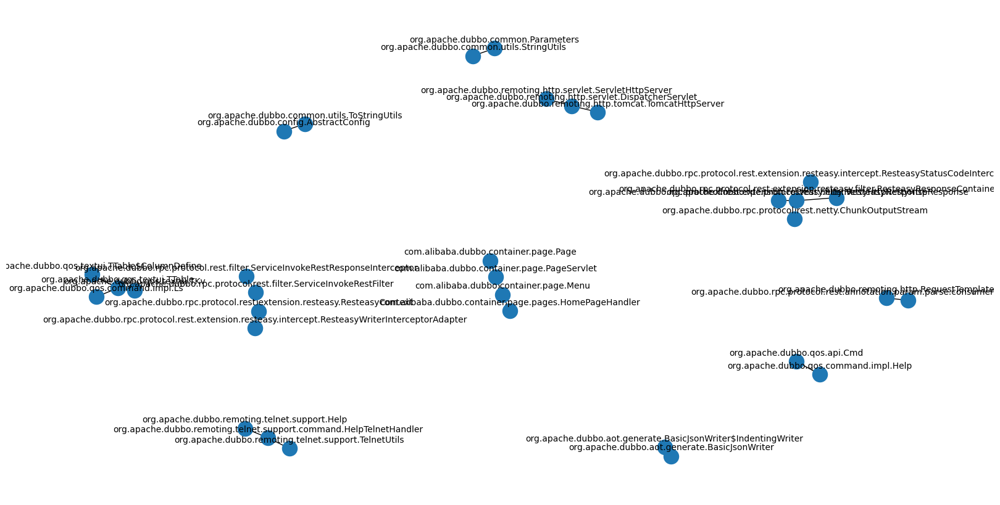

In [368]:
# Create a new graph
G_w_5 = nx.Graph()
    
# Add weighted edges to the graph
G_w_5.add_weighted_edges_from(weighted_edges_list_5)

draw_graph(G_w_5)
plt.show()

In [369]:
# Find connected components
connected_components_w_5 = [G_w_5.subgraph(c).copy() for c in nx.connected_components(G_w_5)]

list_sorted_connected_components(connected_components_w_5)

Feature 1: 5
Feature 2: 4
Feature 3: 4
Feature 4: 4
Feature 5: 3
Feature 6: 3
Feature 7: 2
Feature 8: 2
Feature 9: 2
Feature 10: 2
Feature 11: 2
[['org.apache.dubbo.rpc.protocol.rest.netty.ChunkOutputStream', 'org.apache.dubbo.rpc.protocol.rest.netty.NettyHttpResponse', 'org.apache.dubbo.rpc.protocol.rest.extension.resteasy.filter.ResteasyResponseContainerFilterAdapter', 'org.apache.dubbo.rpc.protocol.rest.extension.resteasy.intercept.ResteasyStatusCodeInterceptor', 'org.apache.dubbo.rpc.protocol.rest.extension.resteasy.filter.ResteasyNettyHttpResponse'], ['org.apache.dubbo.rpc.protocol.rest.extension.resteasy.intercept.ResteasyWriterInterceptorAdapter', 'org.apache.dubbo.rpc.protocol.rest.extension.resteasy.ResteasyContext', 'org.apache.dubbo.rpc.protocol.rest.filter.ServiceInvokeRestFilter', 'org.apache.dubbo.rpc.protocol.rest.filter.ServiceInvokeRestResponseInterceptor'], ['org.apache.dubbo.qos.command.impl.Ls', 'org.apache.dubbo.qos.textui.TTable', 'org.apache.dubbo.qos.textui.TKv'

## Community Detection

In [370]:
leiden_coms_w_5 = leiden_coms_detect(connected_components_w_5)

CONNECTED COMPONENTS 1
Average Internal Degree: FitnessResult(min=1.6, max=1.6, score=1.6, std=0.0)
Modularity Density: FitnessResult(min=None, max=None, score=1.6, std=None)
Communities Count: 1
Communities: [['org.apache.dubbo.rpc.protocol.rest.netty.ChunkOutputStream', 'org.apache.dubbo.rpc.protocol.rest.netty.NettyHttpResponse', 'org.apache.dubbo.rpc.protocol.rest.extension.resteasy.filter.ResteasyResponseContainerFilterAdapter', 'org.apache.dubbo.rpc.protocol.rest.extension.resteasy.intercept.ResteasyStatusCodeInterceptor', 'org.apache.dubbo.rpc.protocol.rest.extension.resteasy.filter.ResteasyNettyHttpResponse']]
CONNECTED COMPONENTS 2
Average Internal Degree: FitnessResult(min=1.3333333333333333, max=1.3333333333333333, score=1.3333333333333333, std=0.0)
Modularity Density: FitnessResult(min=None, max=None, score=1.3333333333333333, std=None)
Communities Count: 1
Communities: [['org.apache.dubbo.remoting.http.servlet.ServletHttpServer', 'org.apache.dubbo.remoting.http.servlet.Dis

In [371]:
# Refresh variable due to the bug in CDlib algorithm
connected_components_w_5 = [G_w_5.subgraph(c).copy() for c in nx.connected_components(G_w_5)]

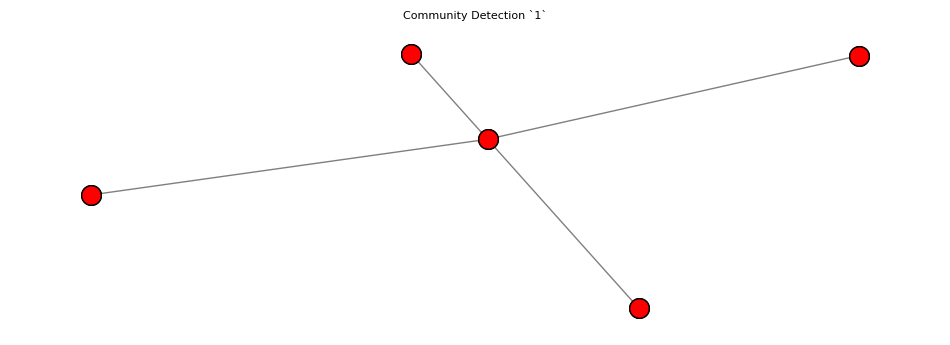

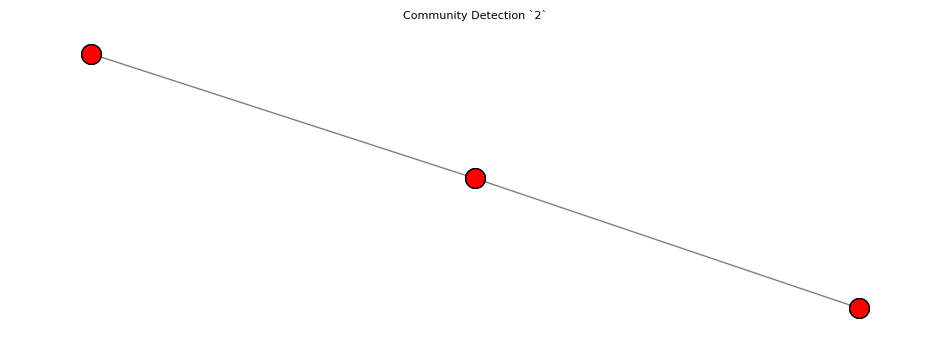

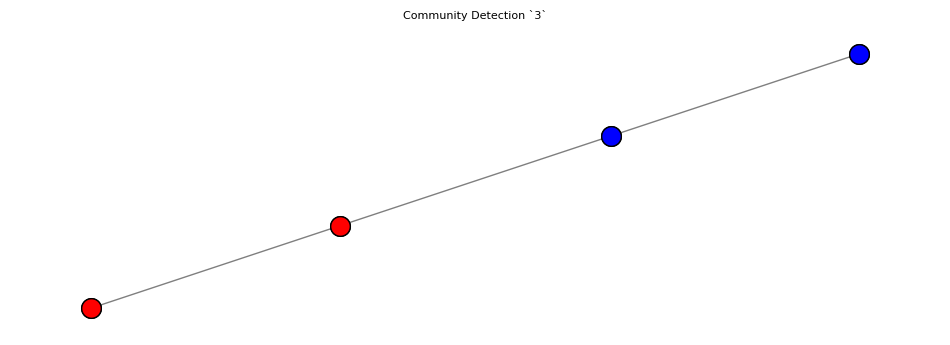

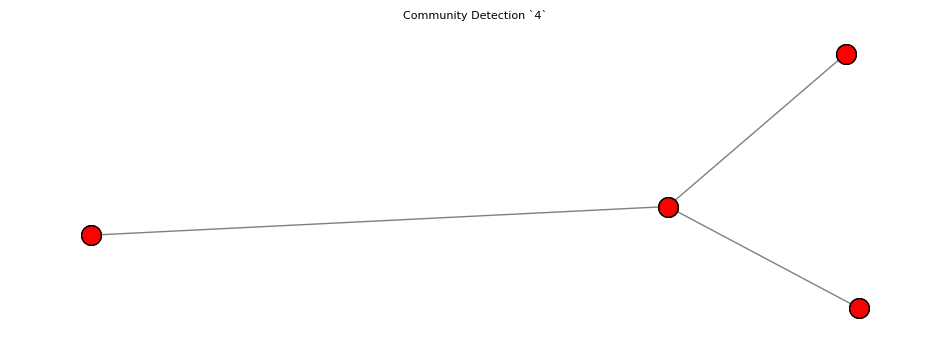

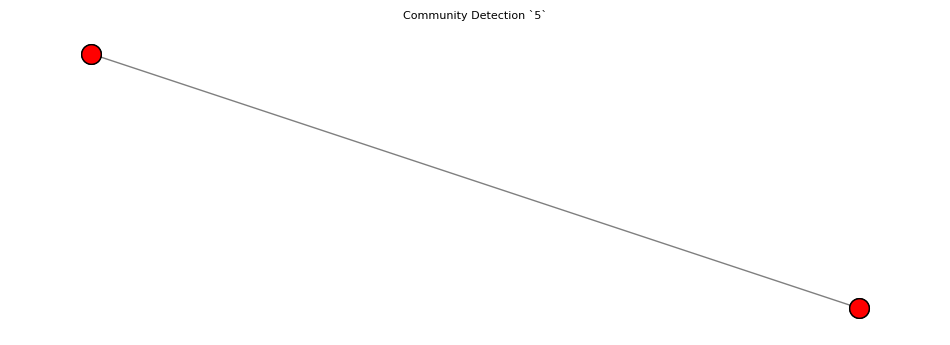

...

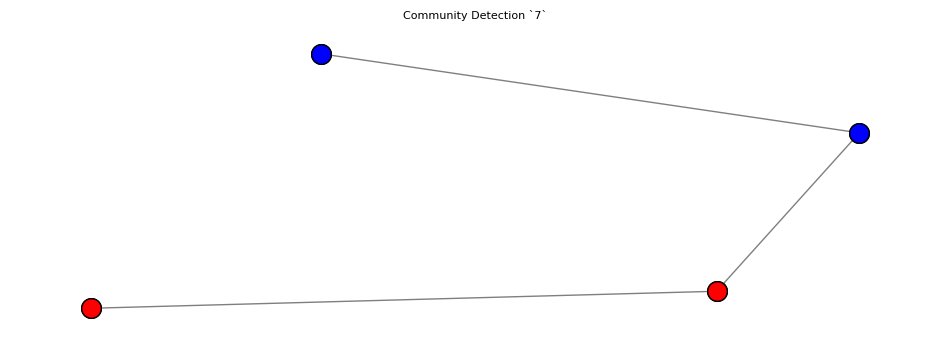

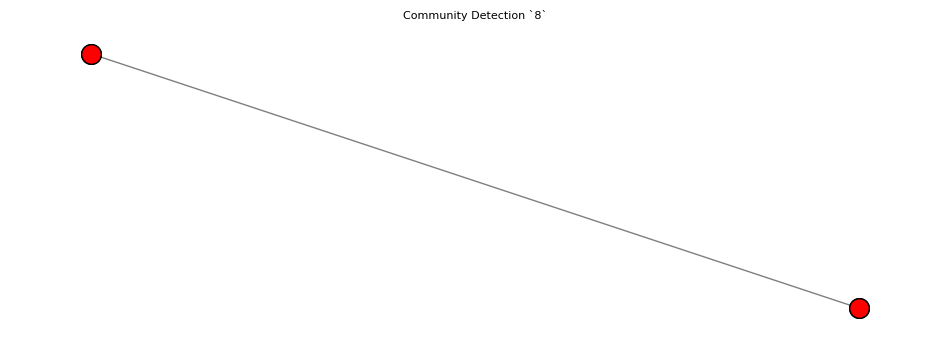

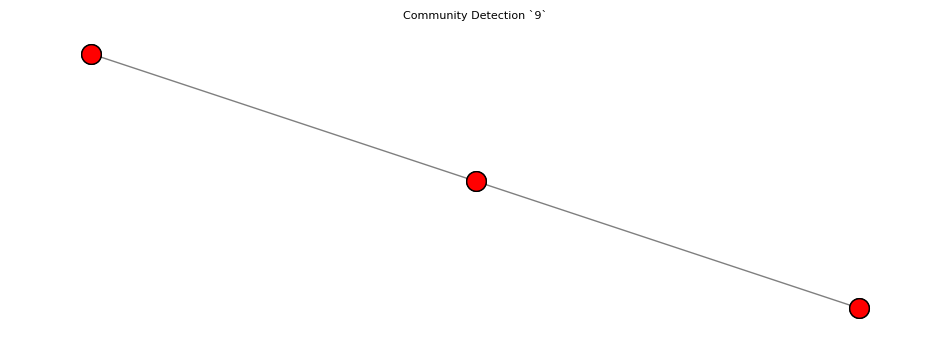

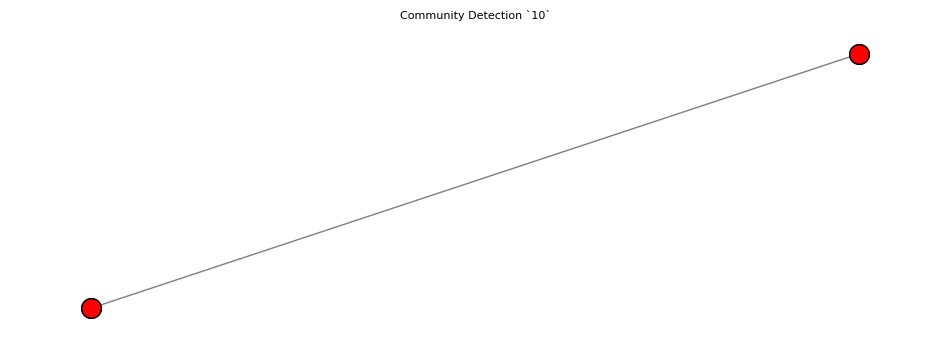

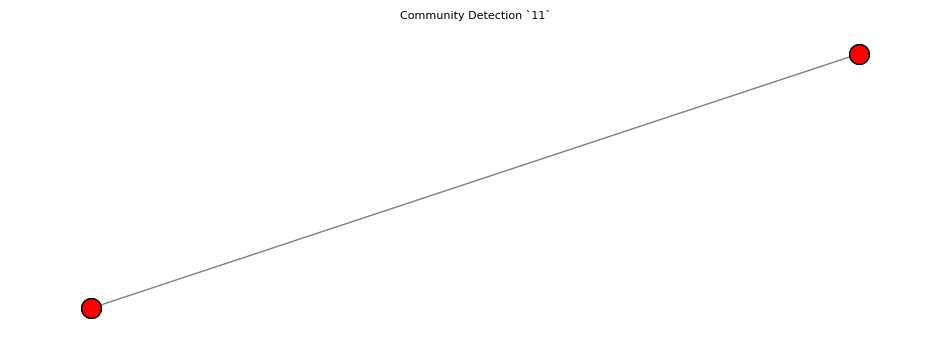

In [372]:
for i, coms in enumerate(leiden_coms_w_5):
    pos = nx.spring_layout(connected_components_w_5[i])
    viz.plot_network_clusters(connected_components_w_5[i], coms, pos, figsize=(12, 4))
    plt.title(f"Community Detection `{i+1}`", fontdict={'fontsize': 8})
    plt.show()

In [373]:
for i, coms in enumerate(leiden_coms_w_5):
    viz.plot_community_graph(connected_components_w_5[i], coms, figsize=(4, 4))
    plt.title(f"Community Graph `{i+1}`", fontdict={'fontsize': 8})
    plt.show()

KeyError: 'org.apache.dubbo.rpc.protocol.rest.netty.ChunkOutputStream'

## Feature Naming & Description

In [374]:
feat_hierarchy_5 = dict()           

for i in range(len(leiden_coms_w_5)):
    feat_hierarchy_5 = features_hierarchy(leiden_coms_w_5[i].communities, nodes_5, feat_hierarchy_5)

print(f'Features Count: {len(feat_hierarchy_5)}')
print(prettify_json(feat_hierarchy_5))

Features Count: 13
{
  "feature_1": {
    "feature_members": {
      "org.apache.dubbo.rpc.protocol.rest.netty.ChunkOutputStream": {
        "description": "This class is responsible for managing the output stream of HTTP response data in chunks, ensuring efficient data transfer and resource management.",
        "roleStereotype": "Service Provider",
        "layer": "Service Layer"
      },
      "org.apache.dubbo.rpc.protocol.rest.netty.NettyHttpResponse": {
        "description": "This class is responsible for managing and constructing HTTP responses in a Netty-based RPC framework, ensuring proper handling of headers, status codes, and response bodies.",
        "roleStereotype": "Service Provider",
        "layer": "Presentation Layer"
      },
      "org.apache.dubbo.rpc.protocol.rest.extension.resteasy.filter.ResteasyResponseContainerFilterAdapter": {
        "description": "This class is responsible for processing and filtering responses in a RESTful service context to ensure th

In [375]:
client_5 = setup_and_test_client(client_args_5, model_5)

https://api.openai.com/v1/
gpt-4o-mini
I’m called ChatGPT. How can I assist you today?


In [376]:
filename_5, timestr_5 = feature_batch_prompt(project_name_5, project_desc_5, model_5, nodes_5, feat_hierarchy_5)

Processing features: 100%|██████████| 13/13 [00:00<00:00, 1393.03it/s]


In [377]:
input_filepath_5 = f"2-Features-Identification-logs/{project_name_5}/{filename_5}.jsonl"

batch_request_5 = send_batch_request(client_5, input_filepath_5, f"{project_name_5}_features_batch_1024tokens")

batch_request_5

Batch(id='batch_tIElr6y0IZamilxX2gHixEcn', completion_window='24h', created_at=1722195421, endpoint='/v1/chat/completions', input_file_id='file-tBSIB647BdivHVP9qcfjfAjY', object='batch', status='validating', cancelled_at=None, cancelling_at=None, completed_at=None, error_file_id=None, errors=None, expired_at=None, expires_at=1722281821, failed_at=None, finalizing_at=None, in_progress_at=None, metadata={'description': 'Apache Dubbo (v3.2.14)_features_batch_1024tokens'}, output_file_id=None, request_counts=BatchRequestCounts(completed=0, failed=0, total=0))

In [386]:
batch_request_5 = client_5.batches.retrieve(batch_request_5.id)

batch_request_5

Batch(id='batch_tIElr6y0IZamilxX2gHixEcn', completion_window='24h', created_at=1722195421, endpoint='/v1/chat/completions', input_file_id='file-tBSIB647BdivHVP9qcfjfAjY', object='batch', status='completed', cancelled_at=None, cancelling_at=None, completed_at=1722195905, error_file_id=None, errors=None, expired_at=None, expires_at=1722281821, failed_at=None, finalizing_at=1722195904, in_progress_at=1722195421, metadata={'description': 'Apache Dubbo (v3.2.14)_features_batch_1024tokens'}, output_file_id='file-PaNqXRVf6bVOkyUvn0uVNMQU', request_counts=BatchRequestCounts(completed=13, failed=0, total=13))

In [387]:
file_response_5 = client_5.files.content(batch_request_5.output_file_id)

batch_output_filepath_5 = f'2-Features-Identification-logs/{project_name_5}/{project_name_5}-features-results-batch-{model_5}-{timestr_5}.jsonl'

merge_batch_output(batch_output_filepath_5, file_response_5.text)

feat_hierarchy_5 = get_result(batch_output_filepath_5, feat_hierarchy_5)

feat_hierarchy_5

{'feature_1': {'feature_name': 'httpResponseManagement',
  'feature_description': 'This feature is responsible for managing and processing HTTP responses in a RESTful context, ensuring efficient data transfer, proper handling of headers, status codes, and response filtering before sending the response back to the client.',
  'feature_members': {'org.apache.dubbo.rpc.protocol.rest.netty.ChunkOutputStream': {'description': 'This class is responsible for managing the output stream of HTTP response data in chunks, ensuring efficient data transfer and resource management.',
    'roleStereotype': 'Service Provider',
    'layer': 'Service Layer'},
   'org.apache.dubbo.rpc.protocol.rest.netty.NettyHttpResponse': {'description': 'This class is responsible for managing and constructing HTTP responses in a Netty-based RPC framework, ensuring proper handling of headers, status codes, and response bodies.',
    'roleStereotype': 'Service Provider',
    'layer': 'Presentation Layer'},
   'org.apache

In [388]:
feat_hierarchy_5 = add_method_hierarchy(nodes_5, hierarchy_5, feat_hierarchy_5)

feat_hierarchy_5

{'feature_1': {'feature_name': 'httpResponseManagement',
  'feature_description': 'This feature is responsible for managing and processing HTTP responses in a RESTful context, ensuring efficient data transfer, proper handling of headers, status codes, and response filtering before sending the response back to the client.',
  'feature_members': {'org.apache.dubbo.rpc.protocol.rest.netty.ChunkOutputStream': {'description': 'This class is responsible for managing the output stream of HTTP response data in chunks, ensuring efficient data transfer and resource management.',
    'roleStereotype': 'Service Provider',
    'layer': 'Service Layer',
    'class_members': {'org.apache.dubbo.rpc.protocol.rest.netty.ChunkOutputStream.close()': {'description': 'The close() method flushes any buffered data and then closes the output stream.',
      'reason': 'The method is provided to ensure that all data is properly flushed and resources are released when the output stream is no longer needed.',
    

In [389]:
write_to_json_file(feat_hierarchy_5, f'../test/output/2-Features-Identification/{project_name_5}-features-{model_5}-{timestr_5}.json')